In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import joblib
import warnings
warnings.filterwarnings('ignore')


In [2]:
#Importation du jeu de donnée
pd.set_option('display.max_columns', None)
pd.set_option('display.max_row', None)

# Pour charger le DataFrame à partir du fichier Joblib
df_cluster = joblib.load('df_cleaned.joblib')


In [3]:
df_cluster.shape

(116750, 34)

In [4]:
df_cluster.isnull().sum()

order_id                                 0
order_item_id                            0
product_id                               0
seller_id                                0
price                                    0
freight_value                            0
product_category_name                 1688
payment_type                             0
payment_installments                     0
payment_value                            0
customer_id                              0
order_approved_at                       15
customer_unique_id                       0
customer_zip_code_prefix                 0
customer_city                            0
customer_state                           0
review_score                             0
seller_zip_code_prefix                   0
seller_city                              0
seller_state                             0
customer_geo_lat                         0
customer_geo_lng                         0
seller_geo_lat                           0
seller_geo_

In [5]:
# Suppression des NANs
df_cluster.dropna(inplace=True)


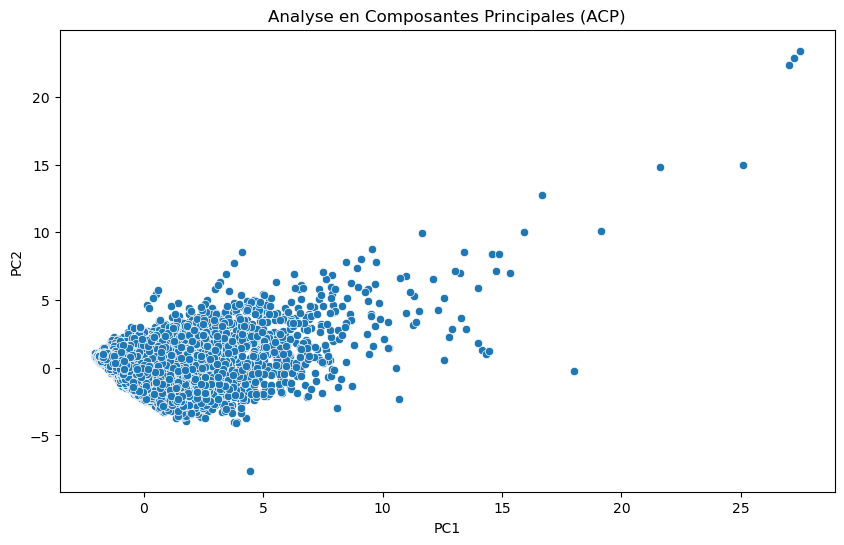

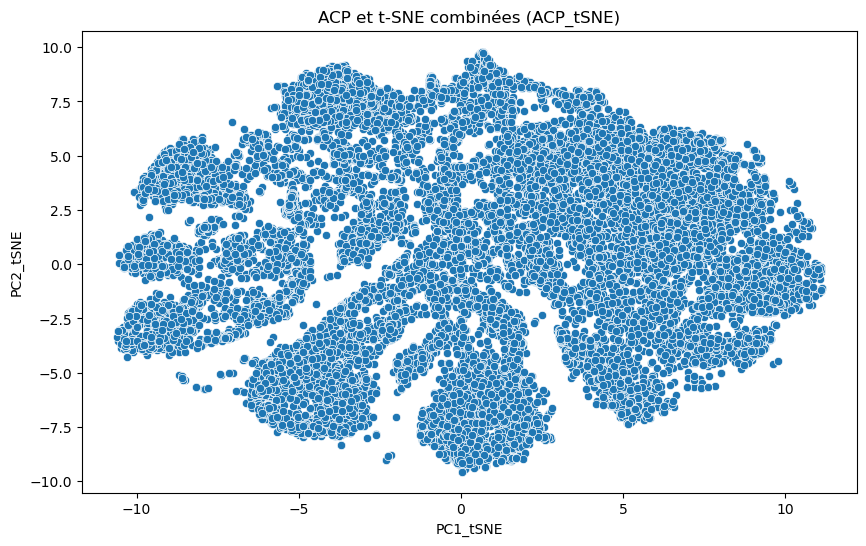

In [6]:
# Import des bibliothèques nécessaires
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Échantillonnage des données
df_cluster_sample = df_cluster.sample(frac=0.2, random_state=42)

# Copie du DataFrame pour éviter de modifier les données originales
df_encoded = df_cluster_sample.copy()

# Supprimer les colonnes spécifiées
columns_to_drop = ['seller_zip_code_prefix','seller_city','seller_state','customer_geo_lat','customer_geo_lng','seller_geo_lat',
                   'seller_geo_lng','time_between_orders_same_customer','days_between_orders_same_customer',
                   'hours_between_orders_same_customer','time_between_orders_all','days_between_orders_all',
                   'hours_between_orders_all', 'order_id','product_id','seller_id', 'order_approved_at',
                   'customer_id']

df_encoded = df_encoded.drop(columns=columns_to_drop, axis=1)
df_encoded.set_index('customer_unique_id', inplace=True)

# Séparation des colonnes numériques et catégoriques
df_numeric = df_encoded.select_dtypes(include=['float64', 'int64'])
df_categorical = df_encoded.select_dtypes(include=['category', 'object', 'bool'])

# Utiliser OneHotEncoder pour encoder les variables catégoriques
encoder = OneHotEncoder(drop='first', sparse=False)
df_categorical_encoded = encoder.fit_transform(df_categorical)

# Standardisation des données numériques
scaler = StandardScaler()
df_numeric_scaled = scaler.fit_transform(df_numeric)

# Concaténer les données encodées
X = pd.concat([pd.DataFrame(df_numeric_scaled, columns=df_numeric.columns),
               pd.DataFrame(df_categorical_encoded, columns=encoder.get_feature_names_out(df_categorical.columns))],
              axis=1)

# Analyse en Composantes Principales (ACP) sur l'ensemble des données
pca = PCA(n_components=2)
pca_result = pca.fit_transform(X)
df_pca = pd.DataFrame(data=pca_result, columns=['PC1', 'PC2'])

# Visualisation ACP
plt.figure(figsize=(10, 6))
sns.scatterplot(x='PC1', y='PC2', data=df_pca)
plt.title('Analyse en Composantes Principales (ACP)')
plt.show()

# t-SNE sur l'ensemble des données
tsne = TSNE(n_components=2, perplexity=30, n_iter=300)
tsne_result = tsne.fit_transform(X)
df_tsne = pd.DataFrame(data=tsne_result, columns=['t-SNE1', 't-SNE2'])

# Analyse en Composantes Principales (ACP) et t-SNE combinées (ACP_tSNE)
pca_tsne = PCA(n_components=2)
pca_tsne_result = pca_tsne.fit_transform(tsne_result)
df_pca_tsne = pd.DataFrame(data=pca_tsne_result, columns=['PC1_tSNE', 'PC2_tSNE'])

# Visualisation ACP et t-SNE combinées
plt.figure(figsize=(10, 6))
sns.scatterplot(x='PC1_tSNE', y='PC2_tSNE', data=df_pca_tsne)
plt.title('ACP et t-SNE combinées (ACP_tSNE)')
plt.show()


# KMEANS

### Clustering KMEANS avec ACP

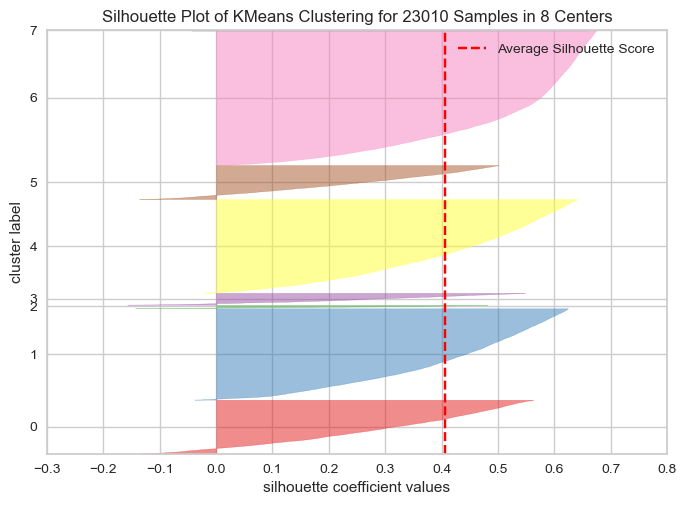

Score de silhouette pour k=8: 0.40683240326389186


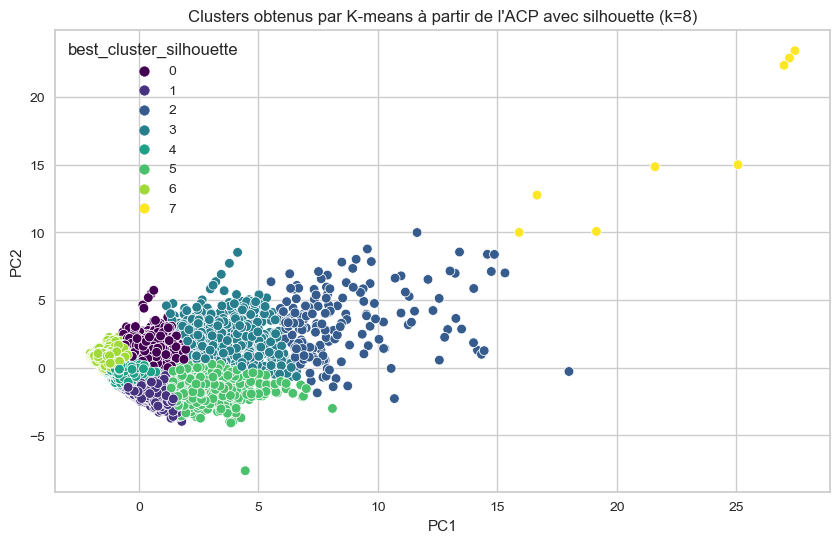

In [7]:
from sklearn.cluster import KMeans
from yellowbrick.cluster import SilhouetteVisualizer
from sklearn.metrics import silhouette_score, davies_bouldin_score

# Appliquer la méthode de silhouette sur les résultats de l'ACP
model_pca_silhouette = KMeans(random_state=42)
visualizer_pca_silhouette = SilhouetteVisualizer(model_pca_silhouette, k=(2, 10), timings=False)

visualizer_pca_silhouette.fit(df_pca[['PC1', 'PC2']])
visualizer_pca_silhouette.show()

# Meilleur nombre de clusters pour l'ACP en utilisant la silhouette
best_k_pca_silhouette = visualizer_pca_silhouette.n_clusters_
kmeans_best_pca_silhouette = KMeans(n_clusters=best_k_pca_silhouette, random_state=42)
df_pca['best_cluster_silhouette'] = kmeans_best_pca_silhouette.fit_predict(df_pca[['PC1', 'PC2']])

# Calcul du score de silhouette pour le meilleur k
silhouette_avg = silhouette_score(df_pca[['PC1', 'PC2']], df_pca['best_cluster_silhouette'])
print(f"Score de silhouette pour k={best_k_pca_silhouette}: {silhouette_avg}")

# Visualisation des clusters pour l'ACP avec le meilleur k en utilisant la silhouette
plt.figure(figsize=(10, 6))
sns.scatterplot(x='PC1', y='PC2', hue='best_cluster_silhouette', data=df_pca, palette='viridis', legend='full')
plt.title(f'Clusters obtenus par K-means à partir de l\'ACP avec silhouette (k={best_k_pca_silhouette})')
plt.show()



### Clustering KMEANS avec ACP_t-SNE

Silhouette Score (ACP_T-SNE, 2 clusters): 0.3930283486843109
Davies-Bouldin Score (ACP_T-SNE, 2 clusters): 1.0446234654690978
----------------------------------------
Silhouette Score (ACP_T-SNE, 3 clusters): 0.41241011023521423
Davies-Bouldin Score (ACP_T-SNE, 3 clusters): 0.8424454630598621
----------------------------------------
Silhouette Score (ACP_T-SNE, 4 clusters): 0.40008479356765747
Davies-Bouldin Score (ACP_T-SNE, 4 clusters): 0.7958419042505671
----------------------------------------
Silhouette Score (ACP_T-SNE, 5 clusters): 0.3760188817977905
Davies-Bouldin Score (ACP_T-SNE, 5 clusters): 0.8680420608859565
----------------------------------------
Silhouette Score (ACP_T-SNE, 6 clusters): 0.3938490152359009
Davies-Bouldin Score (ACP_T-SNE, 6 clusters): 0.8277175237041923
----------------------------------------
Silhouette Score (ACP_T-SNE, 7 clusters): 0.3854256570339203
Davies-Bouldin Score (ACP_T-SNE, 7 clusters): 0.7731855908316401
-------------------------------------

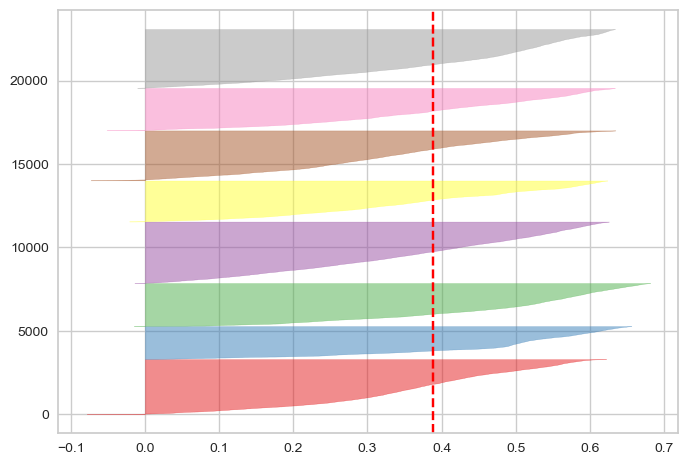

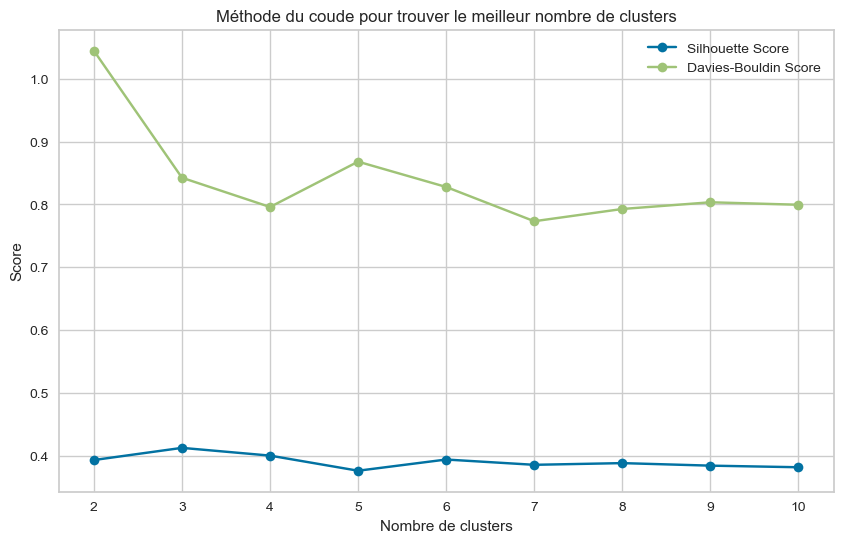

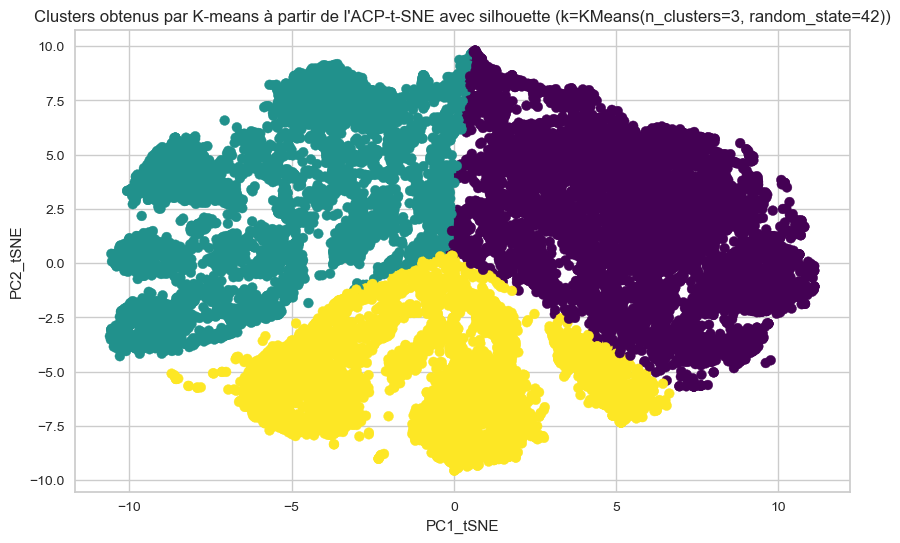

In [8]:
# Appliquer la méthode de silhouette sur les résultats de t-SNE
model_combined_silhouette = KMeans(random_state=42)
visualizer_combined_silhouette = SilhouetteVisualizer(model_combined_silhouette, k=(2, 10), timings=False)

visualizer_combined_silhouette.fit(df_pca_tsne[['PC1_tSNE', 'PC2_tSNE']])
#visualizer_combined_silhouette.show()

# Trouver le meilleur nombre de clusters pour t-SNE en utilisant la silhouette
best_k_combined_silhouette = visualizer_combined_silhouette.n_clusters_
df_pca_tsne['best_cluster_silhouette'] = model_combined_silhouette.fit_predict(df_pca_tsne[['PC1_tSNE', 'PC2_tSNE']])

# Afficher les scores de silhouette et Davies-Bouldin pour différentes valeurs de k
silhouette_scores_kmean = []
davies_bouldin_scores_kmean = []

best_silhouette_score = -1
best_num_clusters = -1

for i in range(2, 11):
    kmeans_best_combined_silhouette = KMeans(n_clusters=i, random_state=42)
    X = df_pca_tsne[['PC1_tSNE', 'PC2_tSNE']]
    clusters = kmeans_best_combined_silhouette.fit_predict(X)
    
    silhouette_avg_combined = silhouette_score(X, clusters)
    davies_bouldin_avg_combined = davies_bouldin_score(X, clusters)
    
    silhouette_scores_kmean.append(silhouette_avg_combined)
    davies_bouldin_scores_kmean.append(davies_bouldin_avg_combined)
    
    print(f"Silhouette Score (ACP_T-SNE, {i} clusters): {silhouette_avg_combined}")
    print(f"Davies-Bouldin Score (ACP_T-SNE, {i} clusters): {davies_bouldin_avg_combined}")
    print("-" * 40)
    
    # Mettre à jour le meilleur score
    if silhouette_avg_combined > best_silhouette_score:
        best_silhouette_score = silhouette_avg_combined
        best_num_clusters = i

# Afficher le meilleur score et le meilleur nombre de clusters
print(f"Le meilleur score de silhouette est : {best_silhouette_score}")
print(f"Le meilleur nombre de clusters est : {best_num_clusters}")

# Tracer le graphique du coude
plt.figure(figsize=(10, 6))
plt.plot(range(2, 11), silhouette_scores_kmean, marker='o', label='Silhouette Score')
plt.plot(range(2, 11), davies_bouldin_scores_kmean, marker='o', label='Davies-Bouldin Score')
plt.title('Méthode du coude pour trouver le meilleur nombre de clusters')
plt.xlabel('Nombre de clusters')
plt.ylabel('Score')
plt.legend()
plt.show()

# Utiliser KMeans best clusters
kmeans_clusters = KMeans(n_clusters=best_num_clusters, random_state=42)
df_pca_tsne['cluster'] = kmeans_clusters.fit_predict(df_pca_tsne[['PC1_tSNE', 'PC2_tSNE']])

# Afficher le scatter plot
plt.figure(figsize=(10, 6))
plt.scatter(df_pca_tsne['PC1_tSNE'], df_pca_tsne['PC2_tSNE'], c=df_pca_tsne['cluster'], cmap='viridis', s=50)
plt.title(f'Clusters obtenus par K-means à partir de l\'ACP-t-SNE avec silhouette (k={kmeans_clusters})')
plt.xlabel('PC1_tSNE')
plt.ylabel('PC2_tSNE')
plt.show()


In [9]:
# Créer un DataFrame avec les scores
scores_df = pd.DataFrame({
    'Nombre de clusters': range(2, 11),
    'Silhouette Score kmean': silhouette_scores_kmean,
    'Davies-Bouldin Score kmean': davies_bouldin_scores_kmean
})

# Afficher le DataFrame
scores_df


,Nombre de clusters,Silhouette Score kmean,Davies-Bouldin Score kmean
0,2,0.393028,1.044623
1,3,0.412410,0.842445
2,4,0.400085,0.795842
3,5,0.376019,0.868042
4,6,0.393849,0.827718
5,7,0.385426,0.773186
6,8,0.388132,0.792684
7,9,0.384100,0.803358
8,10,0.381553,0.799415


# DBSCAN

### ACP avec DBSCAN

Nombre de clusters obtenus par DBSCAN : 3
Silhouette Score (ACP): 0.7533142426858104


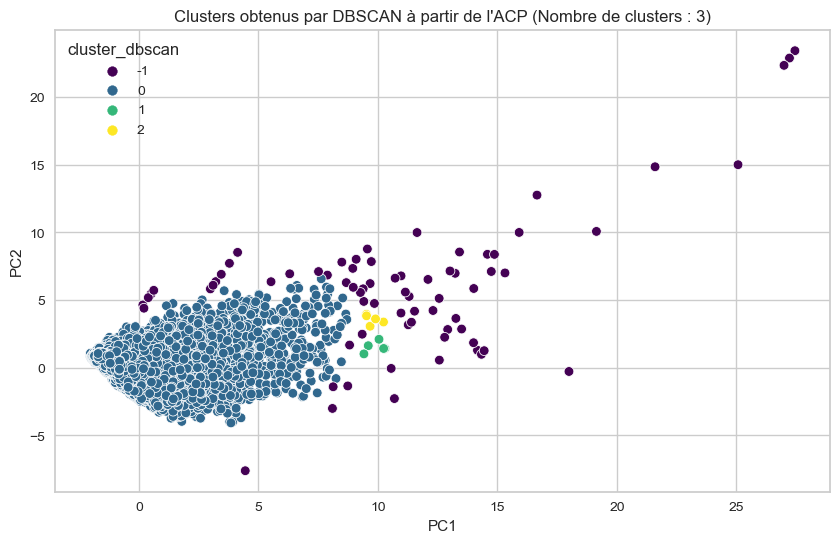

In [10]:
from sklearn.cluster import DBSCAN

# Standardisation des données pour DBSCAN avec ACP
scaler_dbscan_acp = StandardScaler()
df_pca_scaled = scaler_dbscan_acp.fit_transform(df_pca[['PC1', 'PC2']])

# Appliquer DBSCAN
dbscan_acp = DBSCAN(eps=0.5, min_samples=5)
df_pca['cluster_dbscan'] = dbscan_acp.fit_predict(df_pca_scaled)

# Afficher le nombre de clusters
num_clusters_dbscan = len(set(dbscan_acp.labels_)) - (1 if -1 in dbscan_acp.labels_ else 0)
print(f"Nombre de clusters obtenus par DBSCAN : {num_clusters_dbscan}")

# Calculer la silhouette moyenne
silhouette_avg_pca = silhouette_score(df_pca_scaled, df_pca['cluster_dbscan'])
print(f"Silhouette Score (ACP): {silhouette_avg_pca}")

# Visualisation des clusters pour ACP avec DBSCAN
plt.figure(figsize=(10, 6))
sns.scatterplot(x='PC1', y='PC2', hue='cluster_dbscan', data=df_pca, palette='viridis', legend='full')
plt.title(f'Clusters obtenus par DBSCAN à partir de l\'ACP (Nombre de clusters : {num_clusters_dbscan})')
plt.show()


### ACP_T-SNE avec DBSCAN

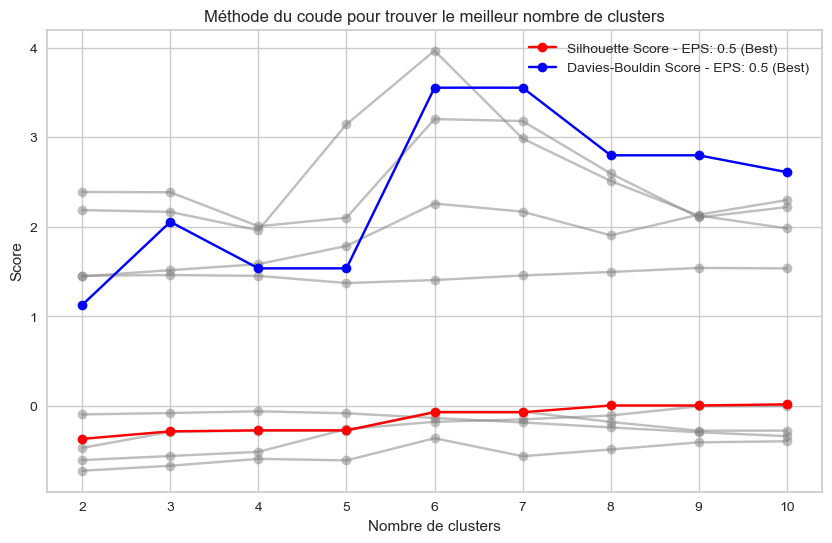

Meilleurs hyperparamètres - EPS: 0.5, Min Samples: 10
Score de silhouette pour DBSCAN avec les meilleurs hyperparamètres : 0.018135054036974907
Score Davies-Bouldin pour DBSCAN avec les meilleurs hyperparamètres : 2.609457061168243


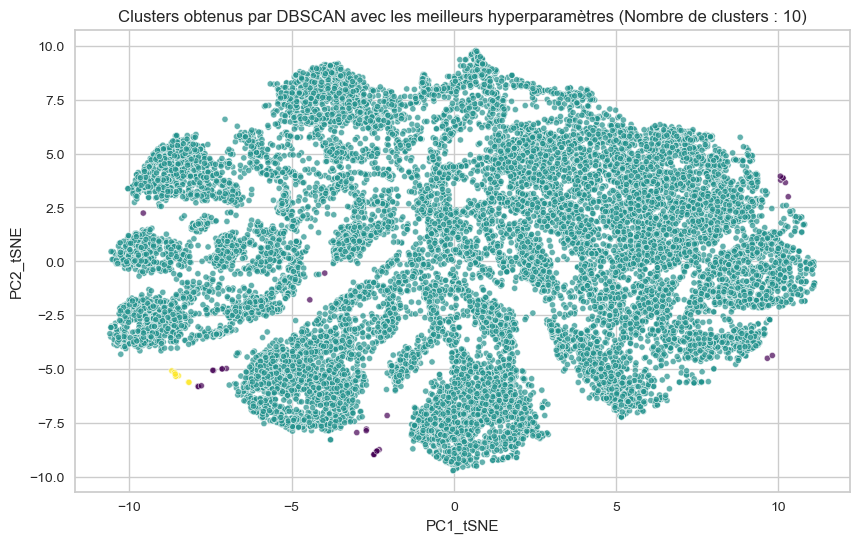

In [11]:
from sklearn.metrics import silhouette_score, davies_bouldin_score


# Hyperparamètres à tester
eps_values = [0.1, 0.2, 0.3, 0.4, 0.5]
min_samples_values = range(2, 11)

best_eps = None
best_min_samples = None
best_silhouette_score = -1
best_davies_bouldin_score = float('inf')

silhouette_scores_dbscan = []
davies_bouldin_scores_dbscan = []

# Tester les hyperparamètres
for eps in eps_values:
    silhouette_eps = []
    davies_bouldin_eps = []
    
    for min_samples in min_samples_values:
        dbscan_acp_tsne = DBSCAN(eps=eps, min_samples=min_samples)
        df_pca_tsne['cluster_dbscan'] = dbscan_acp_tsne.fit_predict(df_pca_tsne[['PC1_tSNE', 'PC2_tSNE']])
        
        silhouette_avg = silhouette_score(df_pca_tsne[['PC1_tSNE', 'PC2_tSNE']], df_pca_tsne['cluster_dbscan'])
        davies_bouldin_avg = davies_bouldin_score(df_pca_tsne[['PC1_tSNE', 'PC2_tSNE']], df_pca_tsne['cluster_dbscan'])
        
        silhouette_eps.append(silhouette_avg)
        davies_bouldin_eps.append(davies_bouldin_avg)
        
        if silhouette_avg > best_silhouette_score:
            best_eps = eps
            best_min_samples = min_samples
            best_silhouette_score = silhouette_avg
            best_davies_bouldin_score = davies_bouldin_avg
    
    silhouette_scores_dbscan.append(silhouette_eps)
    davies_bouldin_scores_dbscan.append(davies_bouldin_eps)

# Tracer le graphique du coude avec uniquement les meilleurs résultats
plt.figure(figsize=(10, 6))

for i, eps in enumerate(eps_values):
    if eps == best_eps:
        plt.plot(range(2, 11), silhouette_scores_dbscan[i], marker='o', label=f'Silhouette Score - EPS: {eps} (Best)', color='red')
        plt.plot(range(2, 11), davies_bouldin_scores_dbscan[i], marker='o', label=f'Davies-Bouldin Score - EPS: {eps} (Best)', color='blue')
    else:
        plt.plot(range(2, 11), silhouette_scores_dbscan[i], marker='o', alpha=0.5, color='gray')
        plt.plot(range(2, 11), davies_bouldin_scores_dbscan[i], marker='o', alpha=0.5, color='gray')

plt.title('Méthode du coude pour trouver le meilleur nombre de clusters')
plt.xlabel('Nombre de clusters')
plt.ylabel('Score')
plt.legend()
plt.show()

print(f"Meilleurs hyperparamètres - EPS: {best_eps}, Min Samples: {best_min_samples}")
print(f"Score de silhouette pour DBSCAN avec les meilleurs hyperparamètres : {best_silhouette_score}")
print(f"Score Davies-Bouldin pour DBSCAN avec les meilleurs hyperparamètres : {best_davies_bouldin_score}")

# Tracer le scatter plot avec le meilleur nombre de clusters
plt.figure(figsize=(10, 6))

# Utiliser les meilleurs hyperparamètres pour le clustering
best_dbscan_acp_tsne = DBSCAN(eps=best_eps, min_samples=best_min_samples)
df_pca_tsne['cluster_dbscan_best'] = best_dbscan_acp_tsne.fit_predict(df_pca_tsne[['PC1_tSNE', 'PC2_tSNE']])

# Afficher le scatter plot avec le meilleur nombre de clusters
plt.scatter(df_pca_tsne['PC1_tSNE'], df_pca_tsne['PC2_tSNE'], c=df_pca_tsne['cluster_dbscan_best'], cmap='viridis', s=20, alpha=0.7, marker='o', edgecolors='w', linewidth=0.5)

plt.title(f'Clusters obtenus par DBSCAN avec les meilleurs hyperparamètres (Nombre de clusters : {best_min_samples})')
plt.xlabel('PC1_tSNE')
plt.ylabel('PC2_tSNE')
plt.show()


In [12]:
# Créer un DataFrame avec les scores
scores_dbscan_df = pd.DataFrame({
    'Nombre de clusters': min_samples_values,
    'Silhouette Score dbscan': silhouette_scores_dbscan[eps_values.index(best_eps)],
    'Davies-Bouldin Score dbscan': davies_bouldin_scores_dbscan[eps_values.index(best_eps)]
})

# Afficher le DataFrame
scores_dbscan_df

,Nombre de clusters,Silhouette Score dbscan,Davies-Bouldin Score dbscan
0,2,-0.367180,1.127705
1,3,-0.282819,2.055012
2,4,-0.271719,1.535932
3,5,-0.271719,1.535932
4,6,-0.069533,3.551702
5,7,-0.069533,3.551702
6,8,0.005648,2.797151
7,9,0.005648,2.797151
8,10,0.018135,2.609457


# Agglomerative Clustering

### Agglomerative Clustering avec ACP

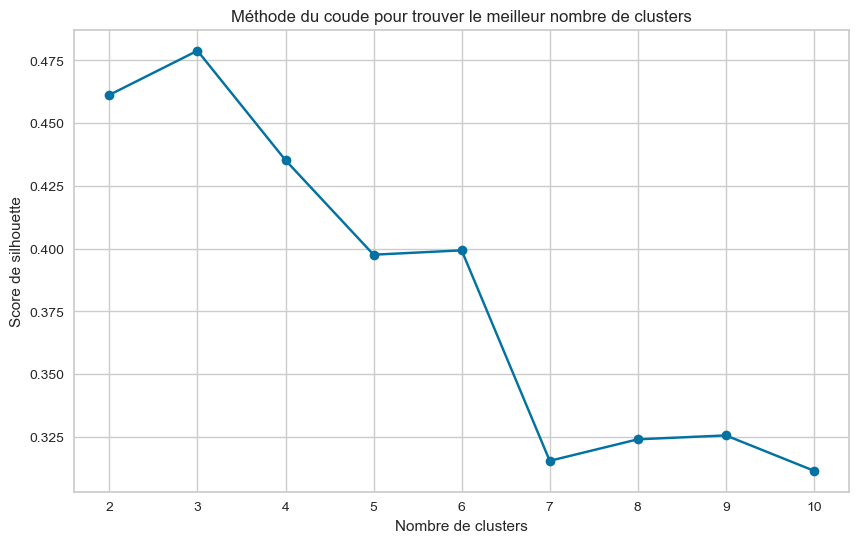

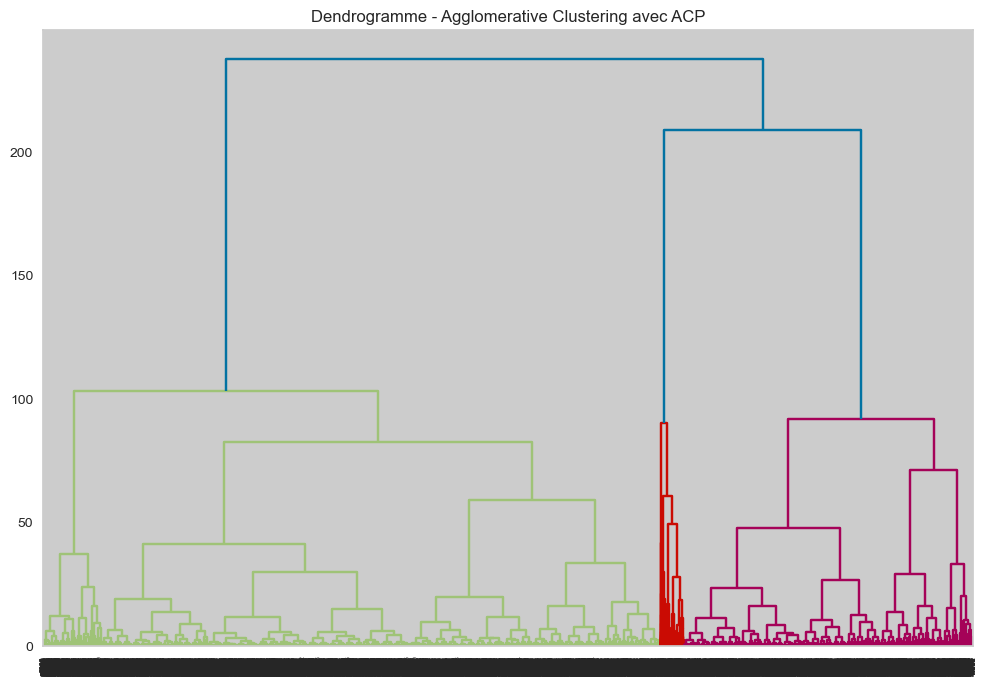

Meilleur nombre de clusters : 3


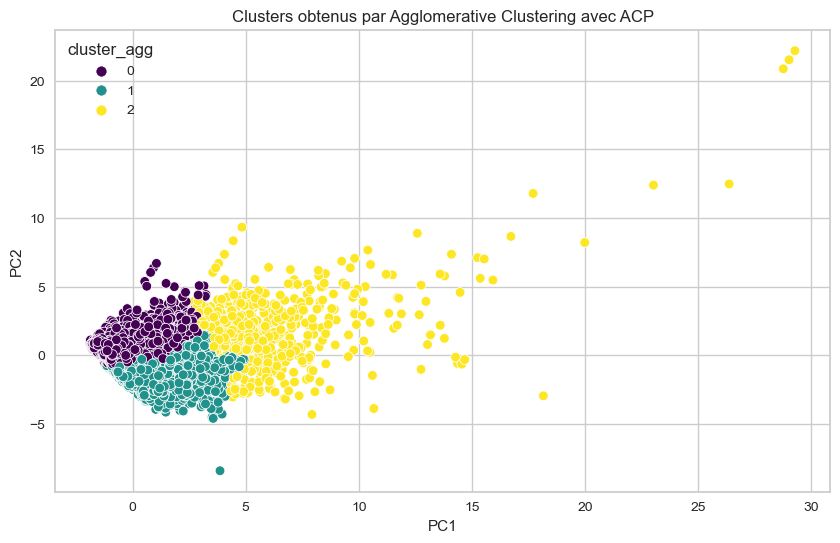

In [13]:
from sklearn.cluster import AgglomerativeClustering
from scipy.cluster.hierarchy import dendrogram, linkage

# Appliquer ACP
pca_ac = PCA(n_components=2)
pca_result_ac = pca_ac.fit_transform(df_numeric_scaled)
df_pca_ac = pd.DataFrame(data=pca_result_ac, columns=['PC1', 'PC2'])

# Trouver le meilleur nombre de clusters en utilisant la méthode du coude
silhouette_scores = []
for n_clusters in range(2, 11):  # Choisissez la plage appropriée
    agg_clustering_ac = AgglomerativeClustering(n_clusters=n_clusters)
    df_pca_ac['cluster_agg'] = agg_clustering_ac.fit_predict(df_pca_ac[['PC1', 'PC2']])
    silhouette_avg_agg_ac = silhouette_score(df_pca_ac[['PC1', 'PC2']], df_pca_ac['cluster_agg'])
    silhouette_scores.append(silhouette_avg_agg_ac)

# Tracer le graphique du coude
plt.figure(figsize=(10, 6))
plt.plot(range(2, 11), silhouette_scores, marker='o')
plt.title('Méthode du coude pour trouver le meilleur nombre de clusters')
plt.xlabel('Nombre de clusters')
plt.ylabel('Score de silhouette')
plt.show()

# Afficher le dendrogramme pour mieux comprendre la structure hiérarchique
linkage_matrix_ac = linkage(df_pca_ac[['PC1', 'PC2']], method='ward')
plt.figure(figsize=(12, 8))
dendrogram(linkage_matrix_ac)
plt.title('Dendrogramme - Agglomerative Clustering avec ACP')
plt.show()

# Choisissez le nombre de clusters en fonction du coude sur le graphique
best_num_clusters = silhouette_scores.index(max(silhouette_scores)) + 2
print(f"Meilleur nombre de clusters : {best_num_clusters}")

# Utiliser le meilleur nombre de clusters pour l'Agglomerative Clustering
agg_clustering_ac = AgglomerativeClustering(n_clusters=best_num_clusters)
df_pca_ac['cluster_agg'] = agg_clustering_ac.fit_predict(df_pca_ac[['PC1', 'PC2']])

# Visualisation des clusters
plt.figure(figsize=(10, 6))
sns.scatterplot(x='PC1', y='PC2', hue='cluster_agg', data=df_pca_ac, palette='viridis', legend='full')
plt.title('Clusters obtenus par Agglomerative Clustering avec ACP')
plt.show()



In [14]:
# Afficher le score de silhouette
print(f"Score de silhouette pour Agglomerative Clustering avec ACP_T-SNE (k={best_num_clusters}): {max(silhouette_scores)}")



Score de silhouette pour Agglomerative Clustering avec ACP_T-SNE (k=3): 0.4788454954375877


### Agglomerative Clustering avec ACP_T-SNE

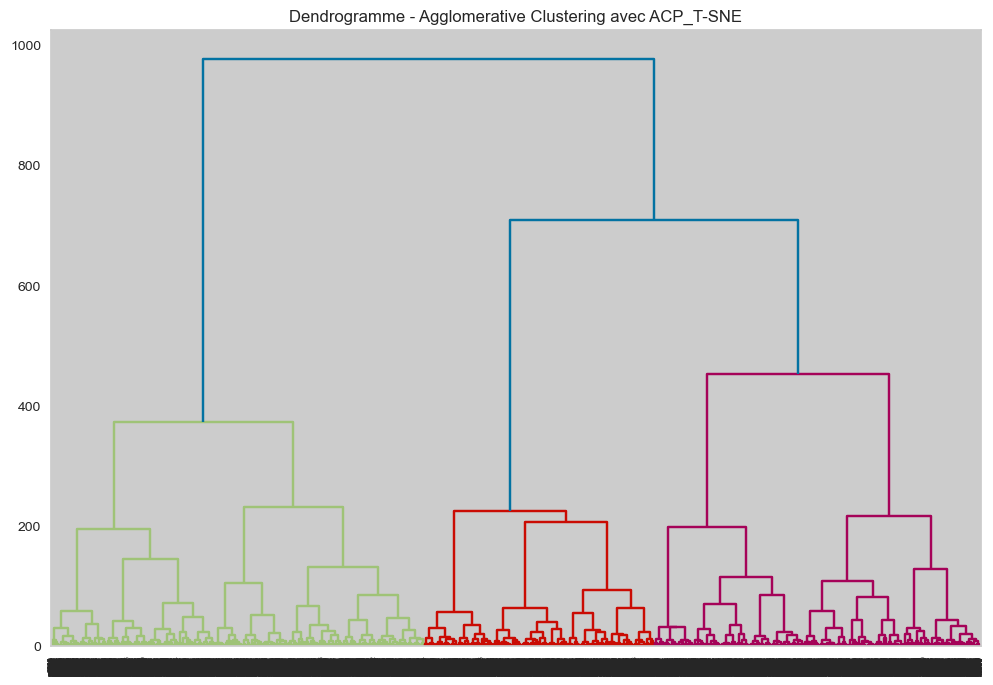

Nombre de clusters : 2
Score silhouette : 0.3762281537055969
Score Davies-Bouldin : 1.0275530931599866
----------------------------------------
Nombre de clusters : 3
Score silhouette : 0.3991580605506897
Score Davies-Bouldin : 0.8420985121308032
----------------------------------------
Nombre de clusters : 4
Score silhouette : 0.38770735263824463
Score Davies-Bouldin : 0.8126237731045702
----------------------------------------
Nombre de clusters : 5
Score silhouette : 0.3546927273273468
Score Davies-Bouldin : 0.9206262747035335
----------------------------------------
Nombre de clusters : 6
Score silhouette : 0.32479599118232727
Score Davies-Bouldin : 0.9450047899609636
----------------------------------------
Nombre de clusters : 7
Score silhouette : 0.3106369972229004
Score Davies-Bouldin : 0.9669904385870647
----------------------------------------
Nombre de clusters : 8
Score silhouette : 0.30588752031326294
Score Davies-Bouldin : 0.9872843686349261
------------------------------

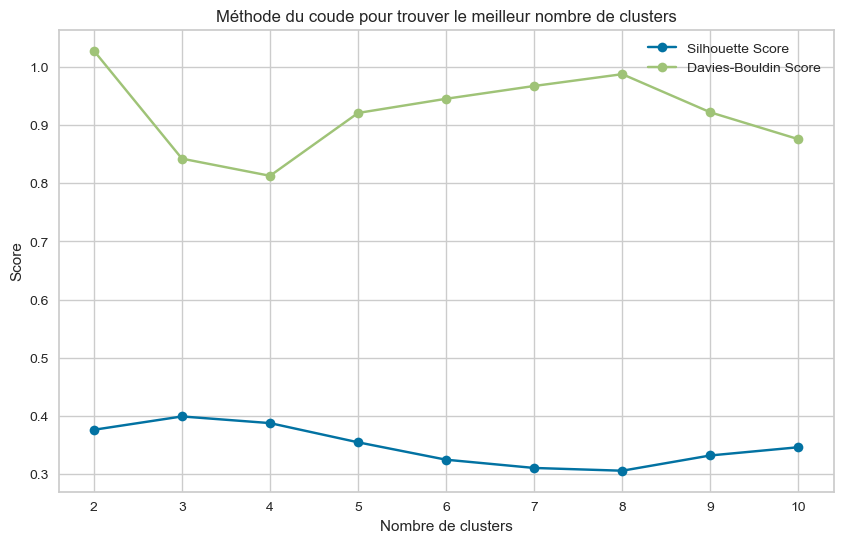

Meilleur nombre de clusters avec Silhouette : 3
Meilleur nombre de clusters avec Davies-Bouldin : 4


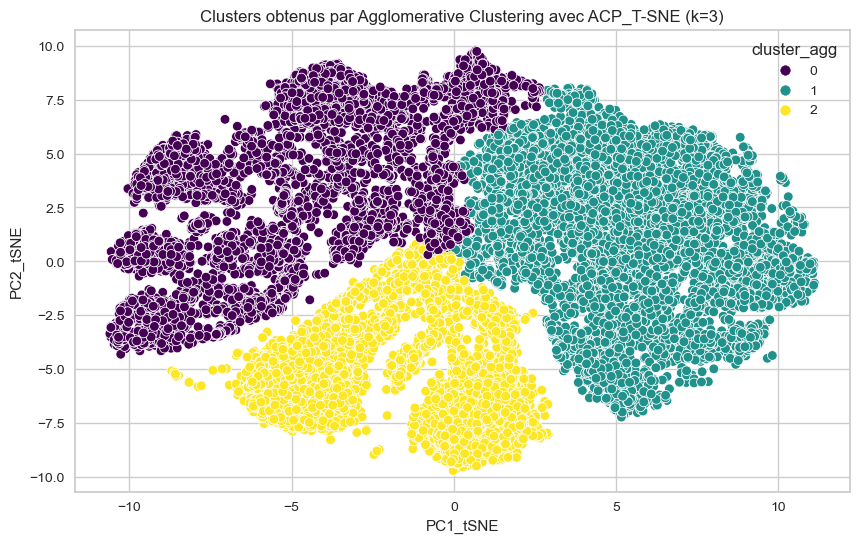

In [15]:
# Appliquer Agglomerative Clustering
agg_clustering_acp_tsne = AgglomerativeClustering()  # Ne pas spécifier le nombre de clusters initiaux
df_pca_tsne['cluster_agg'] = agg_clustering_acp_tsne.fit_predict(df_pca_tsne[['PC1_tSNE', 'PC2_tSNE']])

# Afficher le dendrogramme
linkage_matrix_acp_tsne = linkage(df_pca_tsne[['PC1_tSNE', 'PC2_tSNE']], method='ward')
plt.figure(figsize=(12, 8))
dendrogram(linkage_matrix_acp_tsne)
plt.title('Dendrogramme - Agglomerative Clustering avec ACP_T-SNE')
plt.show()

# Initialiser une liste pour stocker les résultats
results_acp_tsne = []

# Trouver le meilleur nombre de clusters en utilisant la méthode du coude
silhouette_scores_acp_tsne = []
davies_bouldin_scores_acp_tsne = []

for n_clusters in range(2, 11):  # Choisissez la plage appropriée
    # Agglomerative Clustering
    agg_clustering_acp_tsne = AgglomerativeClustering(n_clusters=n_clusters)
    df_pca_tsne['cluster_agg'] = agg_clustering_acp_tsne.fit_predict(df_pca_tsne[['PC1_tSNE', 'PC2_tSNE']])
    
    silhouette_avg_acp_tsne = silhouette_score(df_pca_tsne[['PC1_tSNE', 'PC2_tSNE']], df_pca_tsne['cluster_agg'])
    davies_bouldin_avg_acp_tsne = davies_bouldin_score(df_pca_tsne[['PC1_tSNE', 'PC2_tSNE']], df_pca_tsne['cluster_agg'])
    
    silhouette_scores_acp_tsne.append(silhouette_avg_acp_tsne)
    davies_bouldin_scores_acp_tsne.append(davies_bouldin_avg_acp_tsne)
    
    # Stocker les résultats dans la liste
    results_acp_tsne.append({
        'Nombre de clusters': n_clusters,
        'Score silhouette ac': silhouette_avg_acp_tsne,
        'Score Davies-Bouldin ac': davies_bouldin_avg_acp_tsne
    })
    
    # Afficher le nombre de clusters, le score de silhouette et le score Davies-Bouldin
    print(f"Nombre de clusters : {n_clusters}")
    print(f"Score silhouette : {silhouette_avg_acp_tsne}")
    print(f"Score Davies-Bouldin : {davies_bouldin_avg_acp_tsne}")
    print("-" * 40)

# Créer un DataFrame à partir de la liste des résultats
df_results_acp_tsne = pd.DataFrame(results_acp_tsne)

# Tracer le graphique du coude
plt.figure(figsize=(10, 6))
plt.plot(range(2, 11), silhouette_scores_acp_tsne, marker='o', label='Silhouette Score')
plt.plot(range(2, 11), davies_bouldin_scores_acp_tsne, marker='o', label='Davies-Bouldin Score')
plt.title('Méthode du coude pour trouver le meilleur nombre de clusters')
plt.xlabel('Nombre de clusters')
plt.ylabel('Score')
plt.legend()
plt.show()

# Choisissez le nombre de clusters en fonction du coude sur le graphique de la silhouette
best_num_clusters_acp_tsne_silhouette = silhouette_scores_acp_tsne.index(max(silhouette_scores_acp_tsne)) + 2
print(f"Meilleur nombre de clusters avec Silhouette : {best_num_clusters_acp_tsne_silhouette}")

# Choisissez le nombre de clusters en fonction du coude sur le graphique de Davies-Bouldin
best_num_clusters_acp_tsne_davies_bouldin = davies_bouldin_scores_acp_tsne.index(min(davies_bouldin_scores_acp_tsne)) + 2
print(f"Meilleur nombre de clusters avec Davies-Bouldin : {best_num_clusters_acp_tsne_davies_bouldin}")

# Utiliser le meilleur nombre de clusters pour l'Agglomerative Clustering
best_num_clusters_acp_tsne = best_num_clusters_acp_tsne_silhouette  # Choisissez celui qui vous convient le mieux
agg_clustering_acp_tsne = AgglomerativeClustering(n_clusters=best_num_clusters_acp_tsne)
df_pca_tsne['cluster_agg'] = agg_clustering_acp_tsne.fit_predict(df_pca_tsne[['PC1_tSNE', 'PC2_tSNE']])

# Visualisation des clusters
plt.figure(figsize=(10, 6))
sns.scatterplot(x='PC1_tSNE', y='PC2_tSNE', hue='cluster_agg', data=df_pca_tsne, palette='viridis', legend='full')
plt.title(f'Clusters obtenus par Agglomerative Clustering avec ACP_T-SNE (k={best_num_clusters_acp_tsne})')
plt.show()




### COMPARAISON DES SCORES

In [16]:
# Ajouter la colonne 'Nombre de clusters' aux DataFrames
scores_df['Nombre de clusters'] = range(2, 11)
scores_dbscan_df['Nombre de clusters'] = range(2, 11)
df_results_acp_tsne['Nombre de clusters'] = range(2, 11)

# Fusionner les DataFrames en fonction de la colonne 'Nombre de clusters'
combined_df = pd.merge(scores_df, scores_dbscan_df, on='Nombre de clusters', how='outer')
combined_df = pd.merge(combined_df, df_results_acp_tsne, on='Nombre de clusters', how='outer')

# Afficher le DataFrame combiné
combined_df


,Nombre de clusters,Silhouette Score kmean,Davies-Bouldin Score kmean,Silhouette Score dbscan,Davies-Bouldin Score dbscan,Score silhouette ac,Score Davies-Bouldin ac
0,2,0.392290,1.047631,-0.367180,1.127705,0.376228,1.027553
1,3,0.413677,0.838217,-0.282819,2.055012,0.399158,0.842099
2,4,0.400154,0.795339,-0.271719,1.535932,0.387707,0.812624
3,5,0.375378,0.871074,-0.271719,1.535932,0.354693,0.920626
4,6,0.392930,0.829681,-0.069533,3.551702,0.324796,0.945005
5,7,0.385256,0.773371,-0.069533,3.551702,0.310637,0.966990
6,8,0.387741,0.795417,0.005648,2.797151,0.305888,0.987284
7,9,0.383826,0.804629,0.005648,2.797151,0.332119,0.921697
8,10,0.387645,0.796692,0.018135,2.609457,0.346256,0.875504


### CHOIX

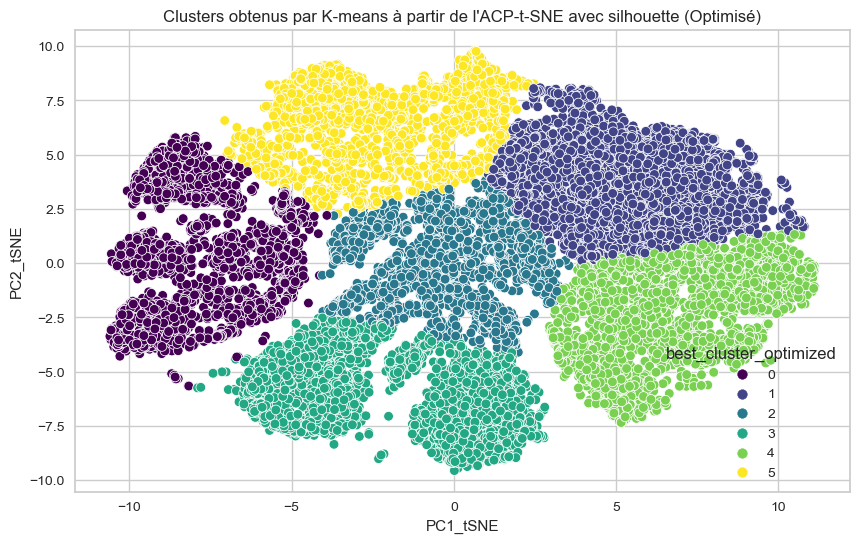

In [11]:
from sklearn.model_selection import ParameterGrid


# Données pour l'ACP-t-SNE
data_pca_tsne = df_pca_tsne[['PC1_tSNE', 'PC2_tSNE']]

# Définir les meilleurs hyperparamètres
best_params = {
    'n_clusters': 6,
    'init': 'k-means++',
    'max_iter': 300,
    'random_state': 42
}

# Initialiser et ajuster le modèle avec les meilleurs paramètres
best_kmeans = KMeans(**best_params)
df_pca_tsne['best_cluster_optimized'] = best_kmeans.fit_predict(data_pca_tsne)

# Visualisation des clusters pour l'ACP-t-SNE avec les meilleurs paramètres
plt.figure(figsize=(10, 6))
sns.scatterplot(x='PC1_tSNE', y='PC2_tSNE', hue='best_cluster_optimized', data=df_pca_tsne, palette='viridis', legend='full')
plt.title(f'Clusters obtenus par K-means à partir de l\'ACP-t-SNE avec silhouette (Optimisé)')
plt.show()



In [12]:
df_cluster_sample['cluster'] = best_kmeans.fit_predict(data_pca_tsne[['PC1_tSNE','PC2_tSNE']])

In [13]:
df_cluster_sample['cluster'].unique()

array([5, 3, 4, 2, 1, 0])

In [20]:
import joblib

# Enregistrez le DataFrame dans un fichier Joblib
joblib.dump(df_cluster_sample, 'df_cluster_sample.joblib')

['df_cluster_sample.joblib']

In [23]:
df_cluster_sample.head()

,order_id,order_item_id,product_id,seller_id,price,freight_value,product_category_name,payment_type,payment_installments,payment_value,customer_id,order_approved_at,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,review_score,seller_zip_code_prefix,seller_city,seller_state,customer_geo_lat,customer_geo_lng,seller_geo_lat,seller_geo_lng,time_between_orders_same_customer,days_between_orders_same_customer,hours_between_orders_same_customer,time_between_orders_all,days_between_orders_all,hours_between_orders_all,order_month,day_of_week,day_of_month,distance,cluster
46999,4c52483789e169329b0dc09e8139b7e2,1,1a080577618e7fe4d9ddd8fb2b47a964,4869f7a5dfa277a7dca6462dcf3b52b2,690.0,16.33,watches_gifts,credit_card,10,706.33,d4bb4211b01632ddd742d89807c73c82,2017-08-01 14:10:14,1e42daf0af58fb971d1598af1fd2497e,15056,sao jose do rio preto,SP,5,14840,guariba,SP,-20.775066,-49.348278,-21.362358,-48.232976,0 days,0,0,0 days 00:06:51,0,0,2017-08,Tuesday,1.0,132.898048,5
4363,ef4d010c07e5ac58d6b9b8f0210df881,1,afbe1e973aefbf72a330e3bc72d4b476,4a3ca9315b744ce9f8e9374361493884,68.9,15.23,bed_bath_table,boleto,1,84.13,e85df93b88aa497ab874a3afadc56bb0,2017-07-07 02:50:36,eda50d1b4b64e6dc8058e29f5fe65c79,35902,itabira,MG,5,14940,ibitinga,SP,-19.652557,-43.200084,-21.766477,-48.831547,0 days,0,0,0 days 00:00:01,0,0,2017-07,Friday,7.0,631.521737,3
48878,1c709af6dc28e45be0dda17b368271df,1,ca140156f7f81f8e406cc66cb8f12a67,6edacfd9f9074789dad6d62ba7950b9c,73.9,9.27,furniture_decor,credit_card,1,83.17,1dd47f0ace79cd4c8b2e0e3e428dc290,2018-08-21 10:50:54,f076fbbb7fc6c69d95e705c8e9561618,5596,sao paulo,SP,3,7135,guarulhos,SP,-23.581214,-46.745350,-23.422313,-46.520062,0 days,0,0,0 days 00:00:00,0,0,2018-08,Tuesday,21.0,28.968920,4
48082,acbaf2e843c77c9749c79030163c8b81,1,e8a2ee67401eb29a9eba28e2eab61a8b,e5a3438891c0bfdb9394643f95273d8e,13.3,15.10,fashion_bags_accessories,credit_card,2,28.40,82c4ae9f59304faecc7ea3ef42b253f4,2018-03-03 14:10:37,14843983d4a159080f6afe4b7f346e7c,24220,niteroi,RJ,1,13483,limeira,SP,-22.905817,-43.106989,-22.568350,-47.447439,0 days,0,0,0 days 00:00:00,0,0,2018-03,Saturday,3.0,447.397792,2
22131,ca2c48ff635d7bd831194de9207ca62d,1,368c6c730842d78016ad823897a372db,1f50f920176fa81dab994f9023523100,59.0,13.43,garden_tools,credit_card,7,72.43,22688d19d082732ac2ba2cb6f3e6b21e,2017-12-19 13:42:58,9046541463206bb0f8dcba0018853adc,13309,itu,SP,5,15025,sao jose do rio preto,SP,-23.280240,-47.284083,-20.802436,-49.395624,0 days,0,0,0 days 00:00:06,0,0,2017-12,Tuesday,19.0,350.402247,1


## la moyenne du score de revue pour chaque cluster, différenciée par région

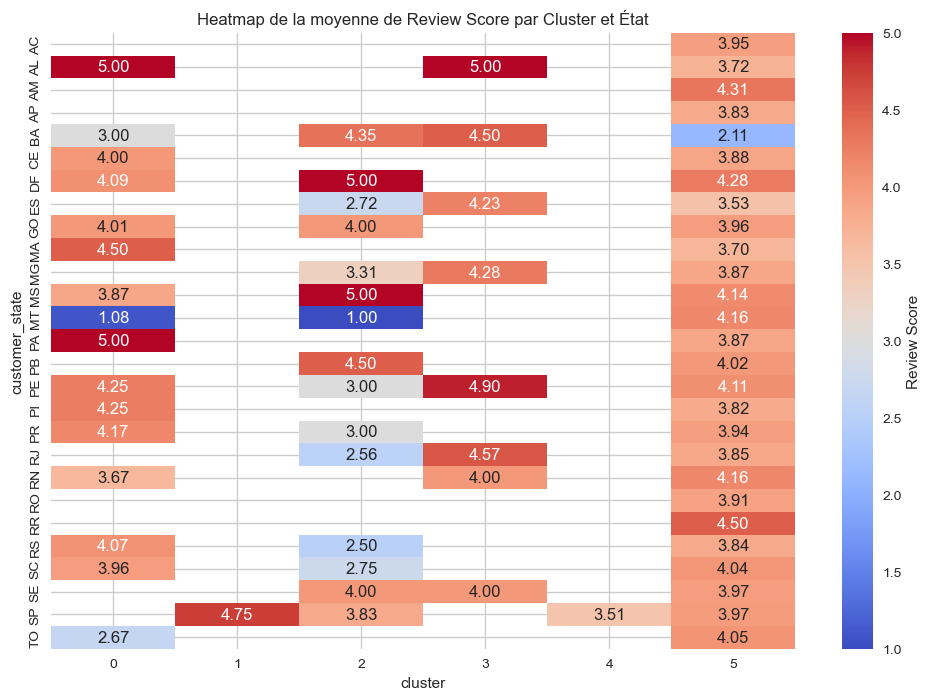

In [14]:
# Groupement par 'customer_state', 'cluster' et calcul de la moyenne de la review_score
grouped_state_cluster_review = df_cluster_sample.groupby(['customer_state', 'cluster']).agg({
    'review_score': 'mean'  # Moyenne de review_score
}).reset_index()

# Créer une table pivot pour avoir 'customer_state' en index, 'cluster' en colonnes, et 'review_score' comme valeurs
pivot_table = grouped_state_cluster_review.pivot(index='customer_state', columns='cluster', values='review_score')

# Créer un heatmap
plt.figure(figsize=(12, 8))
sns.heatmap(pivot_table, annot=True, cmap='coolwarm', fmt='.2f', cbar_kws={'label': 'Review Score'})
plt.title('Heatmap de la moyenne de Review Score par Cluster et État')
plt.show()


## Calcul de la moyenne de review_score pour chaque groupe :

In [15]:
# Sélection des colonnes pertinentes
columns_to_groupby = ['cluster']

# Calcul de la moyenne de review_score pour chaque groupe
average_review_by_cluster_state = df_cluster_sample.groupby(columns_to_groupby)['review_score'].mean().reset_index()

# Définir la colonne "cluster" comme index
average_review_by_cluster_state = average_review_by_cluster_state.set_index('cluster')

# Affichage du tableau
average_review_by_cluster_state



,review_score
cluster,
0,4.046642
1,4.748736
2,3.404934
3,4.403409
4,3.512059
5,3.840481


## Nombre de commande par cluster

In [16]:
# Groupes par client
df_by_customer = df_cluster_sample.groupby('cluster')

# Nombre de commandes par client
orders_per_customer = df_by_customer['order_id'].count()

# Groupes par état du client
df_by_state = df_cluster_sample.groupby('customer_state')

orders_per_customer

cluster
0    4095
1    4350
2    3324
3    4224
4    3939
5    3078
Name: order_id, dtype: int64

## La distance moyenne entre la région du vendeur et du client de chaque cluster

In [17]:
# Sélection des colonnes pertinentes
columns_to_groupby = ['cluster', 'customer_state', 'seller_state']

# Calcul des distances moyennes pour chaque groupe
df_distance = df_cluster_sample.groupby(columns_to_groupby).agg({
    'distance' : 'mean',
    'order_id': 'count',
    'payment_value': 'mean'
}).reset_index()

# Trier le DataFrame par payement_value en ordre décroissant
df_distance = df_distance.sort_values(by='payment_value', ascending=False)

# Définir la colonne "cluster" comme index
df_distance = df_distance.set_index('cluster')

# Affichage du tableau
df_distance

# Utiliser la méthode pivot_table pour mettre le tableau en format pivot
df_pivot_distance = df_distance.pivot_table(index=['customer_state', 'seller_state'], columns='cluster', values=['distance', 'order_id', 'payment_value'], fill_value=0)

# Afficher le tableau pivot
print("Le nombre de commande, la distance et le paiement  moyen de chaque clusters entre l'état l'achat et de vente : ")
df_pivot_distance

Le nombre de commande, la distance et le paiement  moyen de chaque clusters entre l'état l'achat et de vente : 


distance                            \
cluster                                0            1            2   
customer_state seller_state                                          
AC             MG               0.000000     0.000000     0.000000   
               MS               0.000000     0.000000     0.000000   
               RS               0.000000     0.000000     0.000000   
               SC               0.000000     0.000000     0.000000   
               SP               0.000000     0.000000     0.000000   
AL             BA             535.083851     0.000000     0.000000   
               DF               0.000000     0.000000     0.000000   
               GO               0.000000     0.000000     0.000000   
               MG               0.000000     0.000000     0.000000   
               PE               0.000000     0.000000     0.000000   
               PR               0.000000     0.000000     0.000000   
               RJ               0.000000     0.000000     0.000000   
               SC               0.000000     0.000000     0.000000   
               SP               0.000000     0.000000     0.000000   
AM             GO               0.000000     0.000000     0.000000   
               MA               0.000000     0.000000     0.000000   
               MG               0.000000     0.000000     0.000000   
               PR               0.000000     0.000000     0.000000   
               RJ               0.000000     0.000000     0.000000   
               RS               0.000000     0.000000     0.000000   
               SP               0.000000     0.000000     0.000000   
AP             MG               0.000000     0.000000     0.000000   
               PE               0.000000     0.000000     0.000000   
               PR               0.000000     0.000000     0.000000   
               RS               0.000000     0.000000     0.000000   
               SP               0.000000     0.000000     0.000000   
BA             BA               0.000000     0.000000   480.555401   
               CE               0.000000     0.000000  1017.886477   
               DF               0.000000     0.000000   926.347479   
               ES               0.000000     0.000000   866.792628   
               GO               0.000000     0.000000  1214.583447   
               MA               0.000000     0.000000  1344.991082   
               MG               0.000000     0.000000  1027.289004   
               MS               0.000000     0.000000  1772.157125   
               MT               0.000000     0.000000  1686.478535   
               PE               0.000000     0.000000   827.006428   
               PR               0.000000     0.000000  1581.503933   
               RJ               0.000000     0.000000  1166.478677   
               RN               0.000000     0.000000   727.547152   
               RS               0.000000     0.000000  2178.405167   
               SC               0.000000     0.000000  1890.566525   
               SP            1140.561256     0.000000  1365.035581   
CE             BA             637.370914     0.000000     0.000000   
               CE               9.962483     0.000000     0.000000   
               DF               0.000000     0.000000     0.000000   
               ES               0.000000     0.000000     0.000000   
               GO               0.000000     0.000000     0.000000   
               MG               0.000000     0.000000     0.000000   
               PB             330.889424     0.000000     0.000000   
               PE               0.000000     0.000000     0.000000   
               PR               0.000000     0.000000     0.000000   
               RJ               0.000000     0.000000     0.000000   
               RS               0.000000     0.000000     0.000000   
               SC               0.000000     0.000000     0.000000   
               SP               0.000000  

## La somme total de chaque cluster dans son etat

In [18]:
# Sélection des colonnes pertinentes
columns_to_groupby = ['customer_state', 'cluster']

# Calcul des moyennes pour chaque groupe
df_grouped = df_cluster_sample.groupby(columns_to_groupby).agg({
    'order_id': 'count',
    'payment_value': 'sum'
}).reset_index()

# Trier le DataFrame par payement_value en ordre décroissant
df_grouped = df_grouped.sort_values(by='payment_value', ascending=False)

# Définir la colonne "cluster" comme index
df_grouped = df_grouped.set_index('cluster')



# Utiliser la méthode pivot_table pour mettre le tableau en format pivot
df_pivot = df_grouped.pivot_table(index='customer_state', columns='cluster', values=['order_id', 'payment_value'], fill_value=0)

# Afficher le tableau pivot
print("Le nombre de commande et la somme de paiement de chaque cluster en fonction de son état : ")
df_pivot


Le nombre de commande et la somme de paiement de chaque cluster en fonction de son état : 


order_id                              payment_value             \
cluster               0     1     2     3     4    5             0          1   
customer_state                                                                  
AC                    0     0     0     0     0   21          0.00       0.00   
AL                    1     0     0     1     0   79        294.42       0.00   
AM                    0     0     0     0     0   32          0.00       0.00   
AP                    0     0     0     0     0   12          0.00       0.00   
BA                    1     0   587    12     0  196        260.84       0.00   
CE                    5     0     0     0     0  300        419.62       0.00   
DF                  401     0     1     0     0   29      51202.54       0.00   
ES                    0     0    98   351     0   15          0.00       0.00   
GO                  411     0     1     0     0   55      54559.63       0.00   
MA                    4     0     0     0     0  161        452.88       0.00   
MG                    0     0   503  2025     0  119          0.00       0.00   
MS                  149     0     3     0     0   22      21130.35       0.00   
MT                   24     0     2     0     0  193       4129.70       0.00   
PA                    1     0     0     0     0  209        181.55       0.00   
PB                    0     0     2     0     0  132          0.00       0.00   
PE                    4     0     2    10     0  342       1138.57       0.00   
PI                    4     0     0     0     0   89        514.60       0.00   
PR                 1083     0     8     0     0   87     150189.00       0.00   
RJ                    0     0  1040  1820     0  133          0.00       0.00   
RN                    3     0     0     1     0   95        102.60       0.00   
RO                    0     0     0     0     0   54          0.00       0.00   
RR                    0     0     0     0     0   10          0.00       0.00   
RS                 1219     0     8     0     0   97     164672.98       0.00   
SC                  779     0     8     0     0   46     111029.78       0.00   
SE                    0     0     2     4     0   62          0.00       0.00   
SP                    0  4350  1059     0  3939  424          0.00  563507.97   
TO                    6     0     0     0     0   64        597.72       0.00   

                                                            
cluster                 2          3          4          5  
customer_state                                              
AC                   0.00       0.00       0.00    5700.86  
AL                   0.00     165.40       0.00   22036.52  
AM                   0.00       0.00       0.00    4372.10  
AP                   0.00       0.00       0.00    4147.14  
BA               83416.07    1476.90       0.00   76276.89  
CE                   0.00       0.00       0.00   67725.34  
DF                 136.26       0.00       0.00   21680.07  
ES               18274.78   41683.23       0.00   15489.43  
GO                 540.76       0.00       0.00   32070.24  
MA                   0.00       0.00       0.00   38382.12  
MG              124727.60  235131.59       0.00   90025.47  
MS                1791.60       0.00       0.00   17942.15  
MT                 434.36       0.00       0.00   47519.99  
PA                   0.00       0.00       0.00   46367.28  
PB                 535.10       0.00       0.00   35685.77  
PE                 232.62    2025.78       0.00   69516.05  
PI                   0.00       0.00       0.00   19709.22  
PR                5958.94       0.00       0.00   57166.57  
RJ              207974.02  199831.91       0.00  139301.39  
RN                   0.00     158.92       0.00   22556.73  
RO                   0.00       0.00       0.00   12680.99  
RR                   0.00       0.00       0.00    2189.11  
RS                1848.06       0.00       0.00   55422.62 

## La somme des catégories de produits achetés par les clients.

In [20]:
# Groupement par 'customer_state', 'product_category_name', 'cluster'
grouped_data = df_cluster_sample.groupby([ 'product_category_name', 'cluster']).agg({
    'order_id': 'count',  # Nombre de commandes
    'payment_value': 'sum',  # Somme des paiements
}).reset_index()

# Tableau pivot
pivot_table = pd.pivot_table(grouped_data, values='order_id', 
                              index=['cluster'], 
                              columns='product_category_name', aggfunc='sum', fill_value=0)

# Affichage du tableau pivot
print("Tableau Pivot :")
pivot_table


Tableau Pivot :


product_category_name,agro_industry_and_commerce,air_conditioning,art,arts_and_craftmanship,audio,auto,baby,bed_bath_table,books_general_interest,books_imported,books_technical,cds_dvds_musicals,christmas_supplies,cine_photo,computers,computers_accessories,consoles_games,construction_tools_construction,construction_tools_lights,construction_tools_safety,cool_stuff,costruction_tools_garden,costruction_tools_tools,diapers_and_hygiene,drinks,dvds_blu_ray,electronics,fashio_female_clothing,fashion_bags_accessories,fashion_childrens_clothes,fashion_male_clothing,fashion_shoes,fashion_sport,fashion_underwear_beach,fixed_telephony,flowers,food,food_drink,furniture_bedroom,furniture_decor,furniture_living_room,furniture_mattress_and_upholstery,garden_tools,health_beauty,home_appliances,home_appliances_2,home_comfort_2,home_confort,home_construction,housewares,industry_commerce_and_business,kitchen_dining_laundry_garden_furniture,la_cuisine,luggage_accessories,market_place,music,musical_instruments,office_furniture,party_supplies,pc_gamer,perfumery,pet_shop,portateis_cozinha_e_preparadores_de_alimentos,security_and_services,signaling_and_security,small_appliances,small_appliances_home_oven_and_coffee,sports_leisure,stationery,tablets_printing_image,telephony,toys,watches_gifts
cluster,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0,9,9,8,0,17,157,116,392,25,0,9,0,6,1,0,266,42,22,11,12,152,5,6,1,11,4,118,2,75,0,6,8,0,5,7,2,18,8,2,367,13,0,157,326,31,8,0,9,19,271,15,5,2,23,9,1,22,29,3,1,148,70,1,1,8,26,0,367,112,2,190,139,188
1,13,14,7,2,6,160,114,596,24,5,15,1,4,2,0,141,53,39,12,6,127,10,3,2,22,5,96,2,59,1,4,8,1,4,11,0,29,7,1,322,14,2,137,456,27,5,0,21,26,292,14,8,0,55,9,0,31,32,1,0,151,100,0,0,4,24,2,306,127,7,150,178,243
2,4,8,5,1,8,93,78,443,8,0,4,0,6,2,1,247,22,34,8,1,102,16,1,1,17,2,59,3,51,0,3,7,0,4,4,0,14,13,9,344,18,0,156,260,16,8,0,18,14,249,5,7,0,30,7,1,15,106,1,0,99,58,0,0,7,11,2,198,53,1,83,114,164
3,11,10,7,0,12,168,128,445,19,4,11,0,5,1,0,348,39,33,8,5,130,9,6,0,8,0,121,3,105,0,8,14,2,5,10,2,18,17,0,293,17,2,207,316,35,2,1,18,15,238,5,9,0,44,13,3,20,38,4,0,129,78,0,0,4,15,1,344,109,2,182,170,198
4,2,12,13,2,22,175,107,389,30,5,9,0,5,2,0,395,46,27,11,7,147,13,1,1,23,1,89,3,113,0,6,11,2,5,10,0,30,10,2,263,3,0,119,266,41,6,2,17,21,259,13,10,0,26,13,0,19,66,1,0,137,66,1,0,4,23,0,371,63,4,141,112,146
5,16,6,3,0,12,121,104,141,9,0,3,0,4,1,37,258,33,28,6,10,130,10,3,1,2,3,64,0,43,0,2,5,0,3,14,0,11,4,2,195,23,2,131,329,18,31,0,5,16,138,8,14,0,34,11,0,40,95,0,1,88,40,1,0,8,28,15,177,56,5,154,104,222


## Le nombre d'achats et la moyenne des paiements pour chaque cluster en fonction du jour de la semaine

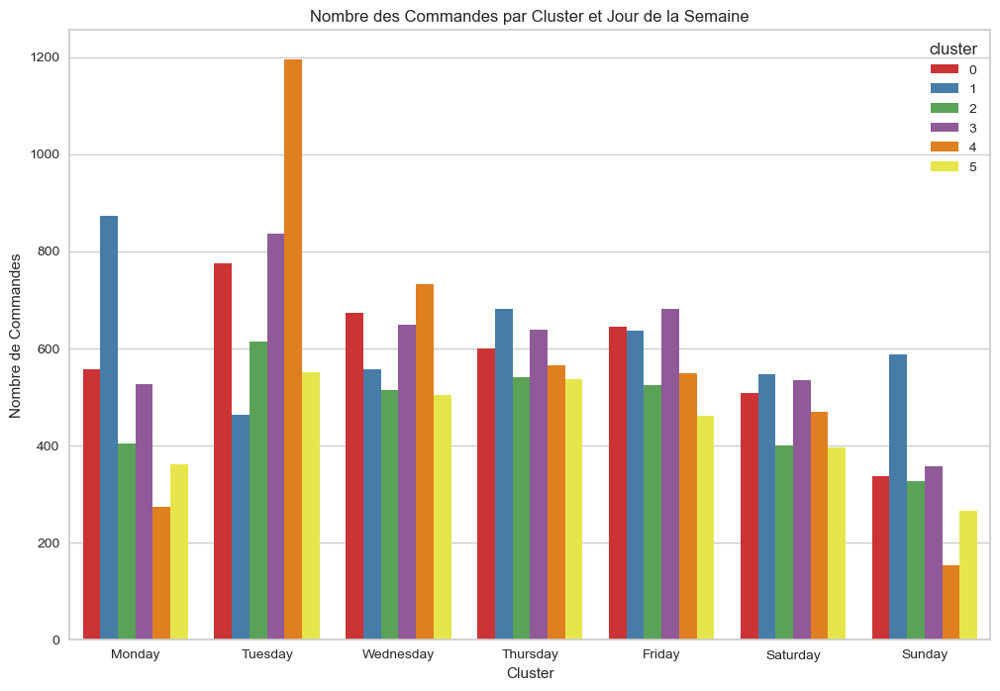

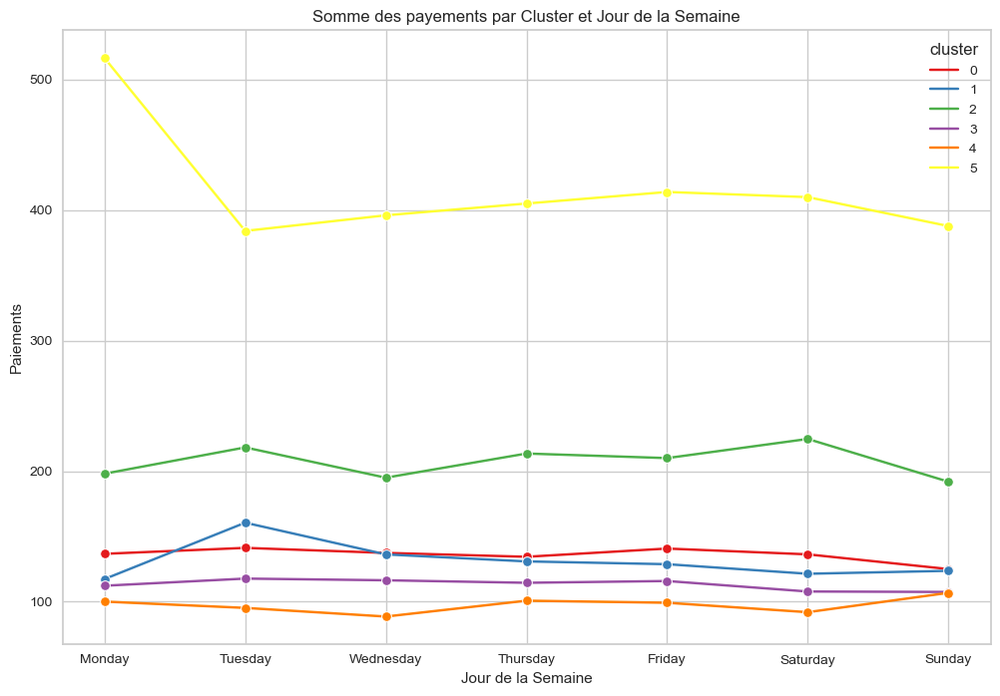

achats et commandes par jour de la semaine:


order_id                           payment_value              \
cluster            0    1    2    3     4    5             0           1   
day_of_week                                                                
Friday           644  637  524  682   550  462    140.725885  128.747033   
Monday           558  874  405  526   273  362    136.699785  117.405160   
Saturday         508  548  400  534   469  396    136.288819  121.426679   
Sunday           336  588  327  357   153  266    125.031905  123.679830   
Thursday         600  682  540  639   565  537    134.424050  130.892962   
Tuesday          776  463  614  837  1196  551    141.240631  160.532117   
Wednesday        673  558  514  649   733  504    137.397073  136.242061   

                                                             
cluster               2           3           4           5  
day_of_week                                                  
Friday       209.994847  115.873504   99.222218  413.773939  
Monday       198.063012  112.267624  100.102894  516.245552  
Saturday     224.659150  107.836292   92.003902  409.828813  
Sunday       191.937156  107.495910  106.816275  387.685489  
Thursday     213.493556  114.513568  100.809929  404.931750  
Tuesday      218.176596  117.732867   95.283436  383.947750  
Wednesday    194.987451  116.436487   88.665948  395.903234

In [21]:
# Groupement par 'customer_state', 'cluster' et 'day_of_week'
grouped_payement_week = df_cluster_sample.groupby(['cluster', 'day_of_week']).agg({
    'payment_value': 'mean',  # Moyenne des paiements
    'order_id': 'count',  # Nombre de commandes
}).reset_index()

# Affichage d'un tableau pivot
pivot_payement_week = pd.pivot_table(grouped_payement_week, values=['payment_value', 'order_id',], 
                                  index=['day_of_week'], 
                                  columns='cluster', fill_value=0)


# Définir l'ordre des jours de la semaine
days_order = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']

# Convertir la colonne 'day_of_week' en catégorie avec l'ordre spécifié
grouped_payement_week['day_of_week'] = pd.Categorical(grouped_payement_week['day_of_week'], categories=days_order, ordered=True)
# Création d'un graphique en utilisant seaborn
plt.figure(figsize=(12, 8))
sns.barplot(x='day_of_week', y='order_id', hue='cluster', data=grouped_payement_week, palette='Set1')
plt.title('Nombre des Commandes par Cluster et Jour de la Semaine')
plt.xlabel('Cluster')
plt.ylabel('Nombre de Commandes')
plt.show()


# Création d'un graphique en utilisant seaborn en courbe avec couleurs personnalisées
plt.figure(figsize=(12, 8))
sns.lineplot(x='day_of_week', y='payment_value', hue='cluster', data=grouped_payement_week, marker='o', palette='Set1')
plt.title('Somme des payements par Cluster et Jour de la Semaine')
plt.xlabel('Jour de la Semaine')
plt.ylabel('Paiements')
plt.show()

print("achats et commandes par jour de la semaine:")
pivot_payement_week


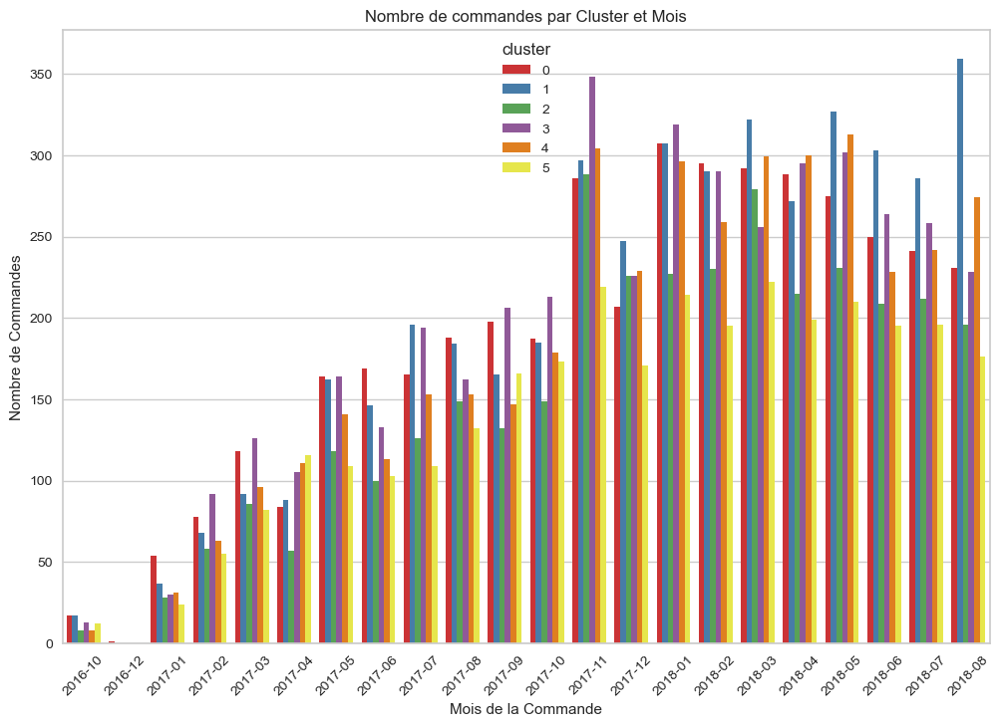

Achats et commandes par mois:


order_id                          payment_value              \
cluster            0    1    2    3    4    5             0           1   
order_month                                                               
2016-10           17   17    8   13    8   12    206.745882  120.747059   
2016-12            1    0    0    0    0    0     19.620000    0.000000   
2017-01           54   37   28   30   31   24    171.499630  151.616486   
2017-02           78   68   58   92   63   55    135.800513  120.366176   
2017-03          118   92   86  126   96   82    146.731610  122.777174   
2017-04           84   88   57  105  111  116    128.924167  138.337045   
2017-05          164  162  118  164  141  109    124.344451  138.858210   
2017-06          169  146  100  133  113  103    119.749467  125.719863   
2017-07          165  196  126  194  153  109    124.139758  134.620204   
2017-08          188  184  149  162  153  132    126.885957  128.607120   
2017-09          198  165  132  206  147  166    125.756364  132.392909   
2017-10          187  185  149  213  179  173    138.879626  118.118811   
2017-11          286  297  288  348  304  219    139.098986  134.239596   
2017-12          207  247  226  226  229  171    129.903720  131.437085   
2018-01          307  307  227  319  296  214    128.496189  140.688762   
2018-02          295  290  230  290  259  195    142.054339  121.260483   
2018-03          292  322  279  256  299  222    130.398014  126.189907   
2018-04          288  272  215  295  300  199    158.246215  139.141581   
2018-05          275  327  231  302  313  210    150.413964  137.946300   
2018-06          250  303  209  264  228  195    133.522040  114.125908   
2018-07          241  286  212  258  242  196    139.535104  130.211329   
2018-08          231  359  196  228  274  176    144.835065  121.157075   

                                                             
cluster               2           3           4           5  
order_month                                                  
2016-10      213.622500   89.343846   86.902500  396.192500  
2016-12        0.000000    0.000000    0.000000    0.000000  
2017-01      181.838214  114.257667   90.027097  393.196250  
2017-02      216.011897  113.555761   86.259048  425.855273  
2017-03      201.452442  114.477381   77.930417  379.667073  
2017-04      187.564737  112.801429   93.839189  374.601121  
2017-05      219.024237  108.450793   90.811418  339.723028  
2017-06      210.609300  112.769699   84.458142  373.109223  
2017-07      192.527063  104.246031  101.970327  260.365413  
2017-08      174.060134  111.770494   88.569739  345.491136  
2017-09      213.054015  110.888010  100.660204  467.088855  
2017-10      226.496779  108.148451   89.791676  618.826416  
2017-11      217.434965  116.268305  103.376414  362.368721  
2017-12      194.562743  124.043363   87.435895  330.042164  
2018-01      219.990352  119.243009  102.754865  334.472991  
2018-02      197.659609  111.122966   98.901390  412.377795  
2018-03      207.310143  108.733633  106.001672  436.500676  
2018-04      216.374326  111.236678  100.500900  405.694523  
2018-05      230.273939  120.609669   95.341661  498.553571  
2018-06      201.305694  113.059924  101.612237  400.938256  
2018-07      231.900189  123.929419   86.844421  481.099643  
2018-08      179.866786  111.268596   90.374270  472.522216

In [38]:
# Ajouter une colonne 'order_month' à votre DataFrame si elle n'existe pas déjà
#df_cluster_sample['order_month'] = df_cluster_sample['order_date'].dt.to_period('M')

# Groupement par 'cluster', 'order_month' et calcul de la moyenne des paiements et du nombre de commandes
grouped_payment_month = df_cluster_sample.groupby(['cluster', 'order_month']).agg({
    'payment_value': 'mean',  # Moyenne des paiements
    'order_id': 'count',  # Nombre de commandes
}).reset_index()

# Convertir la colonne 'order_month' en une période pour l'ordre chronologique dans le graphique
#grouped_payment_month['order_month'] = pd.to_datetime(grouped_payment_month['order_month']).dt.to_period('M')

# Affichage d'un tableau pivot
pivot_payment_month = pd.pivot_table(grouped_payment_month, values=['payment_value', 'order_id'], 
                                     index=['order_month'], 
                                     columns='cluster', fill_value=0)

# Création d'un graphique en utilisant seaborn
plt.figure(figsize=(12, 8))
sns.barplot(x='order_month', y='order_id', hue='cluster', data=grouped_payment_month, palette='Set1')
plt.title('Nombre de commandes par Cluster et Mois')
plt.xlabel('Mois de la Commande')
plt.ylabel('Nombre de Commandes')
plt.xticks(rotation=45)  # Rotation des étiquettes pour une meilleure lisibilité
plt.show()

print("Achats et commandes par mois:")
pivot_payment_month



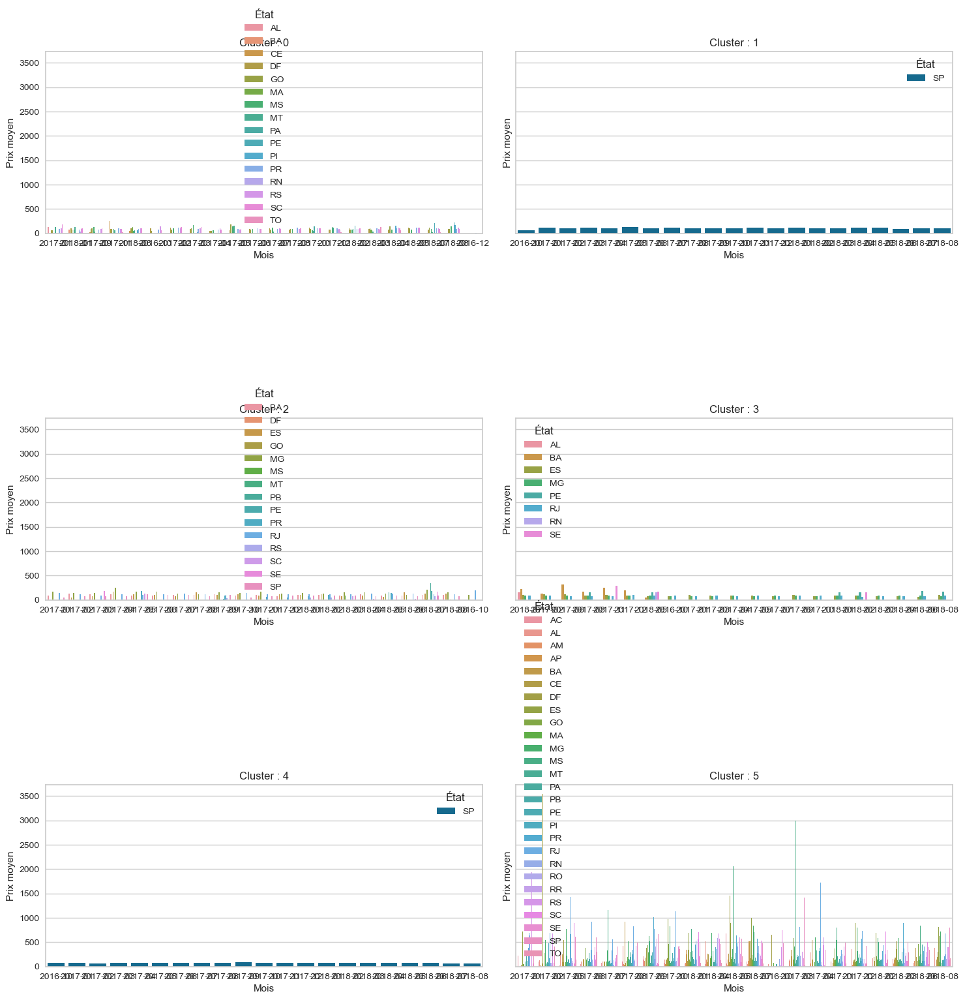

Prix moyen des clusters en fonction de l'état et du mois:


customer_state             AC          AL          AM       AP          BA  \
cluster order_month                                                          
0       2016-10        0.0000    0.000000    0.000000    0.000    0.000000   
        2016-12        0.0000    0.000000    0.000000    0.000    0.000000   
        2017-01        0.0000  131.990000    0.000000    0.000    0.000000   
        2017-02        0.0000    0.000000    0.000000    0.000    0.000000   
        2017-03        0.0000    0.000000    0.000000    0.000    0.000000   
        2017-04        0.0000    0.000000    0.000000    0.000    0.000000   
        2017-05        0.0000    0.000000    0.000000    0.000    0.000000   
        2017-06        0.0000    0.000000    0.000000    0.000    0.000000   
        2017-07        0.0000    0.000000    0.000000    0.000    0.000000   
        2017-08        0.0000    0.000000    0.000000    0.000    0.000000   
        2017-09        0.0000    0.000000    0.000000    0.000    0.000000   
        2017-10        0.0000    0.000000    0.000000    0.000    0.000000   
        2017-11        0.0000    0.000000    0.000000    0.000    0.000000   
        2017-12        0.0000    0.000000    0.000000    0.000    0.000000   
        2018-01        0.0000    0.000000    0.000000    0.000   79.990000   
        2018-02        0.0000    0.000000    0.000000    0.000    0.000000   
        2018-03        0.0000    0.000000    0.000000    0.000    0.000000   
        2018-04        0.0000    0.000000    0.000000    0.000    0.000000   
        2018-05        0.0000    0.000000    0.000000    0.000    0.000000   
        2018-06        0.0000    0.000000    0.000000    0.000    0.000000   
        2018-07        0.0000    0.000000    0.000000    0.000    0.000000   
        2018-08        0.0000    0.000000    0.000000    0.000    0.000000   
1       2016-10        0.0000    0.000000    0.000000    0.000    0.000000   
        2017-01        0.0000    0.000000    0.000000    0.000    0.000000   
        2017-02        0.0000    0.000000    0.000000    0.000    0.000000   
        2017-03        0.0000    0.000000    0.000000    0.000    0.000000   
        2017-04        0.0000    0.000000    0.000000    0.000    0.000000   
        2017-05        0.0000    0.000000    0.000000    0.000    0.000000   
        2017-06        0.0000    0.000000    0.000000    0.000    0.000000   
        2017-07        0.0000    0.000000    0.000000    0.000    0.000000   
        2017-08        0.0000    0.000000    0.000000    0.000    0.000000   
        2017-09        0.0000    0.000000    0.000000    0.000    0.000000   
        2017-10        0.0000    0.000000    0.000000    0.000    0.000000   
        2017-11        0.0000    0.000000    0.000000    0.000    0.000000   
        2017-12        0.0000    0.000000    0.000000    0.000    0.000000   
        2018-01        0.0000    0.000000    0.000000    0.000    0.000000   
        2018-02        0.0000    0.000000    0.000000    0.000    0.000000   
        2018-03        0.0000    0.000000    0.000000    0.000    0.000000   
        2018-04        0.0000    0.000000    0.000000    0.000    0.000000   
        2018-05        0.0000    0.000000    0.000000    0.000    0.000000   
        2018-06        0.0000    0.000000    0.000000    0.000    0.000000   
        2018-07        0.0000    0.000000    0.000000    0.000    0.000000   
        2018-08        0.0000    0.000000    0.000000    0.000    0.000000   
2       2016-10        0.0000    0.000000    0.000000    0.000    0.000000   
        2017-01        0.0000    0.000000    0.000000    0.000   92.458750   
        2017-02        0.0000    0.000000    0.000000    0.000  129.718000   
        2017-03        0.0000    0.000000    0.000000    0.000  122.158000   
        2017-04        0.0000    0.000000    0.000000    0.000  118.760000   
        2017-05        0.0000    0.000000    0.000000    0.000   82.793871   
        2017-06       

In [34]:
import math
import seaborn as sns

# Groupement par 'cluster', 'customer_state', 'month' et calcul de la moyenne du prix
grouped_cluster_state_month_price = df_cluster_sample.groupby(['cluster', 'customer_state', 'order_month']).agg({
    'price': 'mean'  # Moyenne du prix
}).reset_index()

# Affichage d'un tableau pivot
pivot_cluster_state_month_price = pd.pivot_table(grouped_cluster_state_month_price, values='price', 
                                                index=['cluster', 'order_month'], columns='customer_state', fill_value=0)

# Définir le nombre de colonnes pour les sous-plots
num_cols = 2  # Vous pouvez ajuster cela en fonction du nombre de clusters que vous avez

# Calculer le nombre de lignes nécessaire en fonction du nombre de clusters
num_clusters = len(df_cluster_sample['cluster'].unique())
num_rows = math.ceil(num_clusters / num_cols)

# Créer une figure avec plusieurs sous-plots
fig, axes = plt.subplots(num_rows, num_cols, figsize=(15, 15), sharey=True)

# Aplatir la liste des axes pour faciliter l'indexation
axes = axes.flatten()

# Boucle sur chaque cluster pour créer des sous-plots
for i, (cluster, df) in enumerate(grouped_cluster_state_month_price.groupby('cluster')):
    sns.barplot(x='order_month', y='price', hue='customer_state', data=df, ax=axes[i])
    axes[i].set_title(f'Cluster : {cluster}')
    axes[i].set_xlabel('Mois')
    axes[i].set_ylabel('Prix moyen')
    axes[i].legend(title="État")

# Ajuster l'espacement entre les sous-plots
plt.tight_layout()
plt.show()

# Affichage du tableau pivot
print("Prix moyen des clusters en fonction de l'état et du mois:")
pivot_cluster_state_month_price


## Nombre moyenne d'article par commande

In [28]:
# Nombre moyen d'articles par commande
avg_items_per_order = df_cluster_sample.groupby('order_id')['order_item_id'].count().mean()
print("Le nombre moyen d'articles par commande est de :",avg_items_per_order)

Le nombre moyen d'articles par commande est de : 1.0515011652881232


## La prix moyen pour chaque cluster de clients

In [29]:
# Groupement par 'cluster' et calcul de la moyenne du prix
grouped_cluster_state_price = df_cluster_sample.groupby(['cluster']).agg({
    'price': 'mean'  # Moyenne du prix
}).reset_index()

# Définir la colonne "cluster" comme index
grouped_cluster_state_price = grouped_cluster_state_price.set_index('cluster')

# Affichage du tableau
print("Prix moyen des clusters:")
grouped_cluster_state_price



Prix moyen des clusters:


,price
cluster,
0,95.104216
1,106.733413
2,106.943415
3,287.145862
4,73.704715
5,85.659064


In [30]:
# Nombre moyen d'articles par commande
avg_items_per_order = df_cluster_sample.groupby('order_id')['order_item_id'].count().mean()
print("Le nombre moyen d'articles par commande est de :",avg_items_per_order)

Le nombre moyen d'articles par commande est de : 1.0515011652881232


## La moyenne du temps entre les commandes et la moyenne du temps entre les commandes effectuées par le même client suré par la colonne , groupées par cluster.

In [31]:
# Groupby par catégorie de produit avec agrégations et lambda
grouped_summary = df_cluster_sample.groupby( 'cluster').agg({
    'time_between_orders_all': lambda x: x.mean() if 'time_between_orders_all' in df_cluster_sample.columns else np.nan,
    'time_between_orders_same_customer': lambda x: x.mean() if 'time_between_orders_same_customer' in df_cluster_sample.columns else np.nan,
}).reset_index()

# Définir la colonne "cluster" comme index
grouped_summary = grouped_summary.set_index('cluster')

# Renommer les colonnes pour plus de clarté
grouped_summary.columns = ['Avg time between orders all', 'Avg time between orders same customer']

# Afficher le résumé
grouped_summary

,Avg time between orders all,Avg time between orders same customer
cluster,,
0,0 days 00:32:14.417946842,2 days 03:50:26.666178980
1,0 days 00:09:49.750173330,3 days 02:48:27.931823434
2,0 days 00:06:09.028840315,2 days 01:09:14.905282331
3,0 days 00:08:15.645255950,2 days 10:24:22.515487447
4,0 days 00:06:24.080020258,1 days 18:29:40.824512534
5,0 days 00:07:22.358146067,2 days 10:27:47.407771535


## Le prix moyen de chaque cluster en fonction de son état

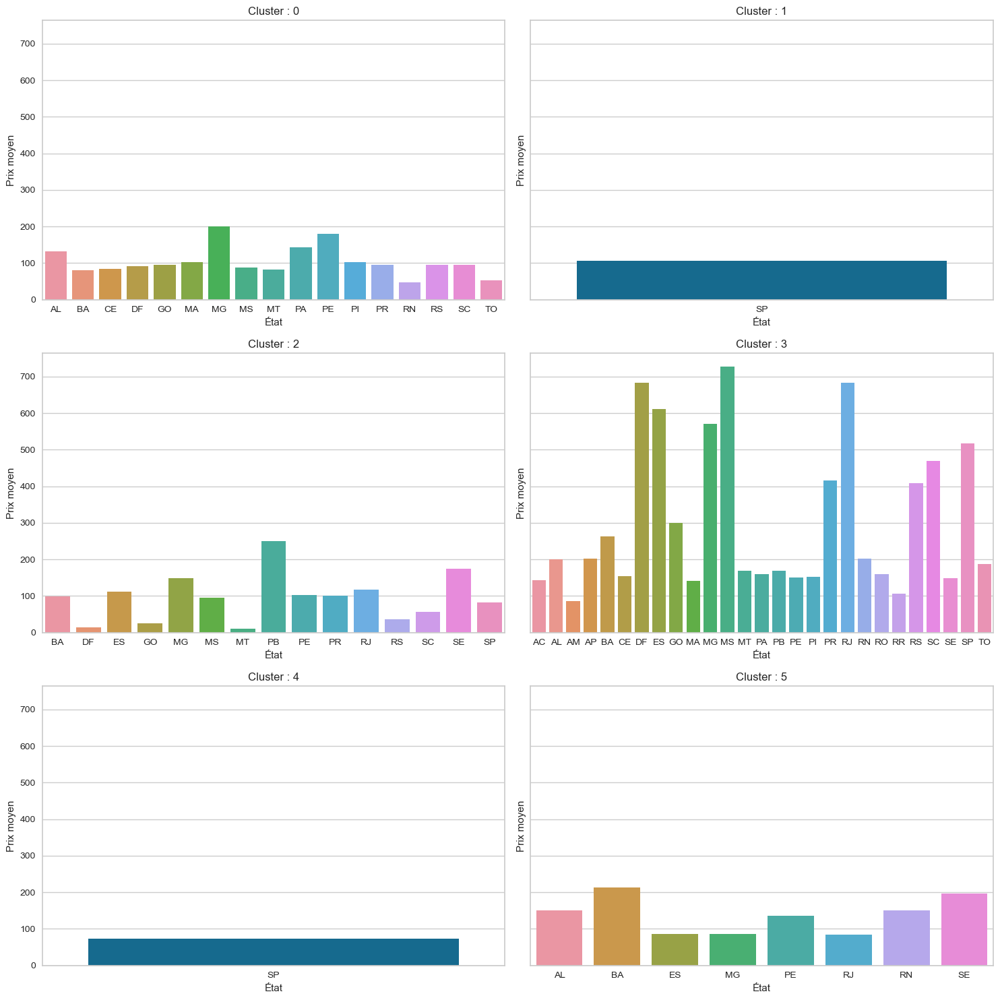

Prix moyen des cluster en fonction de l'état:


customer_state,AC,AL,AM,AP,BA,CE,DF,ES,GO,MA,MG,MS,MT,PA,PB,PE,PI,PR,RJ,RN,RO,RR,RS,SC,SE,SP,TO
cluster,,,,,,,,,,,,,,,,,,,,,,,,,,,
0,0.00000,131.990000,0.000000,0.000000,79.990000,84.7640,92.059107,0.000000,96.061119,102.240000,199.900000,88.118067,82.137500,143.000000,0.000000,179.828571,102.947500,96.097886,0.000000,47.663333,0.000000,0.000,95.399409,95.587189,0.000000,0.000000,53.048333
1,0.00000,0.000000,0.000000,0.000000,0.000000,0.0000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000,0.000000,0.000000,0.000000,106.733413,0.000000
2,0.00000,0.000000,0.000000,0.000000,99.060489,0.0000,15.000000,111.411685,26.180000,0.000000,147.927957,95.200000,10.400000,0.000000,249.450000,102.155000,0.000000,101.292500,117.400071,0.000000,0.000000,0.000,36.937778,57.076250,174.950000,82.823110,0.000000
3,143.96381,200.202025,86.085938,202.670833,262.830211,154.8362,682.446296,610.696667,299.850000,142.008137,570.052857,727.043636,169.575751,159.670622,169.754167,150.550117,152.746404,415.456552,682.171667,202.376316,159.989815,107.095,407.871237,468.580217,148.758871,517.721493,186.754687
4,0.00000,0.000000,0.000000,0.000000,0.000000,0.0000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000,0.000000,0.000000,0.000000,73.704715,0.000000
5,0.00000,149.900000,0.000000,0.000000,212.372500,0.0000,0.000000,86.616361,0.000000,0.000000,85.831036,0.000000,0.000000,0.000000,0.000000,136.141429,0.000000,0.000000,83.980225,149.900000,0.000000,0.000,0.000000,0.000000,196.575000,0.000000,0.000000


In [32]:
import math

# Groupement par 'cluster', 'customer_state', et calcul de la moyenne du prix
grouped_cluster_state_price = df_cluster_sample.groupby(['cluster', 'customer_state']).agg({
    'price': 'mean'  # Moyenne du prix
}).reset_index()

# Affichage d'un tableau pivot
pivot_cluster_state_price = pd.pivot_table(grouped_cluster_state_price, values='price', 
                                           index='cluster', columns='customer_state', fill_value=0)


# Définir le nombre de colonnes pour les sous-plots
num_cols = 2  # Vous pouvez ajuster cela en fonction du nombre de clusters que vous avez

# Calculer le nombre de lignes nécessaire en fonction du nombre de clusters
num_clusters = len(df_cluster_sample['cluster'].unique())
num_rows = math.ceil(num_clusters / num_cols)

# Créer une figure avec plusieurs sous-plots
fig, axes = plt.subplots(num_rows, num_cols, figsize=(15, 15), sharey=True)

# Aplatir la liste des axes pour faciliter l'indexation
axes = axes.flatten()

# Boucle sur chaque cluster pour créer des sous-plots
for i, (cluster, df) in enumerate(grouped_cluster_state_price.groupby('cluster')):
    sns.barplot(x='customer_state', y='price', data=df, ax=axes[i])
    axes[i].set_title(f'Cluster : {cluster}')
    axes[i].set_xlabel('État')
    axes[i].set_ylabel('Prix moyen')

# Ajuster l'espacement entre les sous-plots
plt.tight_layout()
plt.show()

# Affichage du tableau pivot
print("Prix moyen des cluster en fonction de l'état:")
pivot_cluster_state_price



## Répartition par méthode de paiements

Le montant total des paiements par méthode de paiement:
 payment_type
boleto          796806.58
credit_card    3030962.98
debit_card       43834.43
voucher          75755.73
Name: payment_value, dtype: float64


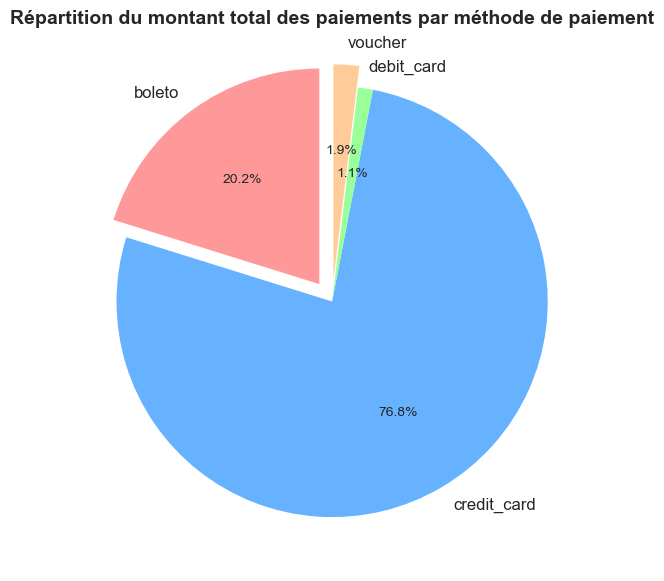

Calcule de la fréquence des paiments par cluster : 

cluster          0     1     2     3     4     5
payment_type                                    
boleto         955   103   537   542  1512   868
credit_card   2910  4173  2575  2371  1874  3076
debit_card      49    26    45    37   114    65
voucher        187    25   137   117   449   263


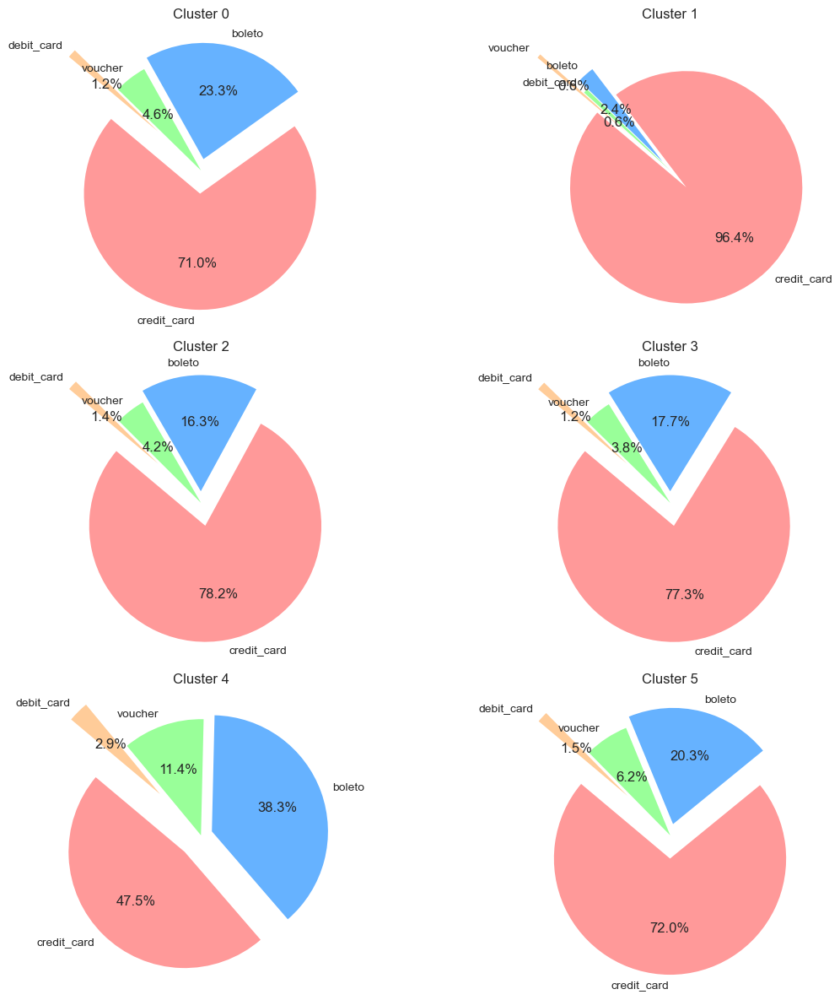

In [33]:
# Groupes par méthode de paiement
df_by_payment_type = df_cluster_sample.groupby('payment_type')

# Montant total des paiements par méthode de paiement
total_payment_by_method = df_by_payment_type['payment_value'].sum()
print('Le montant total des paiements par méthode de paiement:\n',total_payment_by_method)

explode = (0.1, 0, 0, 0.1)

plt.figure(figsize=(7, 7))
# Créer le camembert
patches, texts, autotexts = plt.pie(total_payment_by_method, labels=total_payment_by_method.index, autopct='%1.1f%%', startangle=90, colors=['#FF9999', '#66B2FF', '#99FF99', '#FFCC99'], explode=explode)

# Ajouter des titres à chaque portion
for text, autotext in zip(texts, autotexts):
    text.set_fontsize(12)
    autotext.set_fontsize(10)

plt.title('Répartition du montant total des paiements par méthode de paiement', fontsize=14, fontweight='bold')
plt.show()


# Groupement par 'cluster' et 'payment_type', et calcul de la fréquence des paiements
grouped_cluster_payment = df_cluster_sample.groupby(['cluster', 'payment_type']).agg({
    'order_id': 'count'  # Nombre de paiements
}).reset_index()

# Renommer la colonne 'order_id' en 'payment_frequency' pour refléter la fréquence
grouped_cluster_payment.rename(columns={'order_id': 'payment_frequency'}, inplace=True)

# Création d'un tableau pivot
pivot_cluster_payment = pd.pivot_table(grouped_cluster_payment, values='payment_frequency',
                                       index='payment_type', columns='cluster', fill_value=0)

print('Calcule de la fréquence des paiments par cluster : \n')
print(pivot_cluster_payment)

# Tri des clusters
clusters = sorted(df_cluster_sample['cluster'].unique())

# Calcul du nombre de lignes nécessaire pour les subplots
num_rows = int(np.ceil(len(clusters) / 2))

# Créez un subplot avec le nombre approprié de lignes et de colonnes
fig, axes = plt.subplots(num_rows, 2, figsize=(12, 4 * num_rows))

# Aplatir les axes s'il n'y a qu'une seule ligne
axes = axes.flatten()

# Parcourez chaque cluster trié et créez un pie plot
for i, cluster in enumerate(clusters):
    cluster_data = df_cluster_sample[df_cluster_sample['cluster'] == cluster]
    grouped_payment = cluster_data['payment_type'].value_counts()

    # Calculer l'explosion pour séparer les tranches
    explode = (0.2, 0.1, 0, 0.5)


    # Plot pie plot sur l'axe correspondant avec explode
    axes[i].pie(grouped_payment, labels=grouped_payment.index, autopct='%1.1f%%', startangle=140, explode=explode, colors=['#FF9999', '#66B2FF', '#99FF99', '#FFCC99'])
    axes[i].set_title(f"Cluster {cluster}")

# Ajustez l'espacement entre les subplots
plt.tight_layout()

# Affichez les subplots
plt.show()


In [34]:
from datetime import timedelta
from sklearn.cluster import KMeans
from yellowbrick.cluster import SilhouetteVisualizer
from sklearn.metrics import silhouette_score
from sklearn.preprocessing import StandardScaler
import pandas as pd
import matplotlib.pyplot as plt

# Définir la fonction pour attribuer le segment RFM
def assign_rfm_segment(row, quantiles):
    recency = row['Recency']
    frequency = row['Frequency']
    monetary = row['Monetary']

    # Déterminer le segment en fonction des quantiles
    if recency <= quantiles.loc[0.2, 'Recency']:
        if frequency <= quantiles.loc[0.2, 'Frequency'] and monetary <= quantiles.loc[0.2, 'Monetary']:
            return 'Perdus'
        elif frequency <= quantiles.loc[0.2, 'Frequency'] and monetary > quantiles.loc[0.2, 'Monetary']:
            return 'À Risque'
        elif frequency > quantiles.loc[0.2, 'Frequency'] and monetary <= quantiles.loc[0.2, 'Monetary']:
            return 'Loyaliste Potentiels'
        else:
            return 'Champion'
    elif frequency > quantiles.loc[0.8, 'Frequency'] and monetary > quantiles.loc[0.8, 'Monetary']:
        return 'Loyal'  # Ajout de la catégorie "Loyal" pour les clients loyaux
    
    return 'Autre'

# Définir la fonction pour mettre à jour le modèle RFM
def update_rfm_model(data, frequency_update_days):
    # Calcul de Recency avec la fréquence de mise à jour
    max_date = data['order_approved_at'].max()
    data['Recency'] = (max_date - data['order_approved_at']).dt.days

    # Calcul de Frequency et Monetary
    rfm_data = data.groupby(['customer_unique_id', 'cluster']).agg({
        'Recency': 'min',
        'order_id': 'count',
        'payment_value': 'sum',
        'order_approved_at': 'max'
    }).reset_index()

    rfm_data.columns = ['customer_unique_id', 'cluster', 'Recency', 'Frequency', 'Monetary', 'order_approved_at']

    # Calcul des quantiles pour chaque variable RFM
    quantiles = rfm_data[['Recency', 'Frequency', 'Monetary']].quantile(q=[0.2, 0.4, 0.6, 0.8])

    # Appliquer la fonction pour attribuer le label à chaque ligne
    rfm_data['RFM_Segment'] = rfm_data.apply(lambda row: assign_rfm_segment(row, quantiles), axis=1)

    # Standardisation des données
    scaler = StandardScaler()
    rfm_scaled = scaler.fit_transform(rfm_data[['Recency', 'Frequency', 'Monetary']])

    # Application du modèle K-means
    kmeans = KMeans(n_clusters=6, random_state=42)
    rfm_data['RFM_Cluster'] = kmeans.fit_predict(rfm_scaled)

    return rfm_data, rfm_scaled

    

In [35]:
# Calcul de Recency
max_date = df_cluster_sample['order_approved_at'].max()
df_cluster_sample['Recency'] = (max_date - df_cluster_sample['order_approved_at']).dt.days

# Calcul de Frequency et Monetary
rfm_data = df_cluster_sample.groupby(['customer_unique_id', 'cluster']).agg({
    'Recency': 'min',
    'order_id': 'count',
    'payment_value': 'sum'
}).reset_index()

rfm_data.columns = ['customer_unique_id', 'cluster', 'Recency', 'Frequency', 'Monetary']

# Calcul des quantiles pour chaque variable RFM
quantiles = rfm_data[['Recency', 'Frequency', 'Monetary']].quantile(q=[0.2, 0.4, 0.6, 0.8])

# Appliquer la fonction pour attribuer le label à chaque ligne
rfm_data['RFM_Segment'] = rfm_data.apply(lambda row: assign_rfm_segment(row, quantiles), axis=1)

# Afficher le DataFrame résultant
rfm_data

,customer_unique_id,cluster,Recency,Frequency,Monetary,RFM_Segment
0,0000f6ccb0745a6a4b88665a16c9f078,3,320,1,43.62,Autre
1,00090324bbad0e9342388303bb71ba0a,1,157,1,63.66,Autre
2,000ed48ceeb6f4bf8ad021a10a3c7b43,1,100,1,20.75,Autre
3,000fbf0473c10fc1ab6f8d2d286ce20c,2,33,1,362.38,À Risque
4,0010fb34b966d44409382af9e8fd5b77,1,175,1,61.80,Autre
5,0014a5a58da615f7b01a4f5e194bf5ea,1,222,1,99.82,Autre
6,00196c4c9a3af7dd2ad10eade69c926f,4,29,1,37.58,Perdus
7,001a34eb30ecb8e3aacb07c475ca4dd1,1,48,1,161.71,À Risque
8,001deb796b28a3a128d6113857569aa4,2,66,1,63.33,À Risque
9,001f3c4211216384d5fe59b041ce1461,1,527,1,35.84,Autre


In [36]:
rfm_data.head()

,customer_unique_id,cluster,Recency,Frequency,Monetary,RFM_Segment
0,0000f6ccb0745a6a4b88665a16c9f078,3,320,1,43.62,Autre
1,00090324bbad0e9342388303bb71ba0a,1,157,1,63.66,Autre
2,000ed48ceeb6f4bf8ad021a10a3c7b43,1,100,1,20.75,Autre
3,000fbf0473c10fc1ab6f8d2d286ce20c,2,33,1,362.38,À Risque
4,0010fb34b966d44409382af9e8fd5b77,1,175,1,61.80,Autre


## Histogramme de la Recency, Frequency et Monetary 

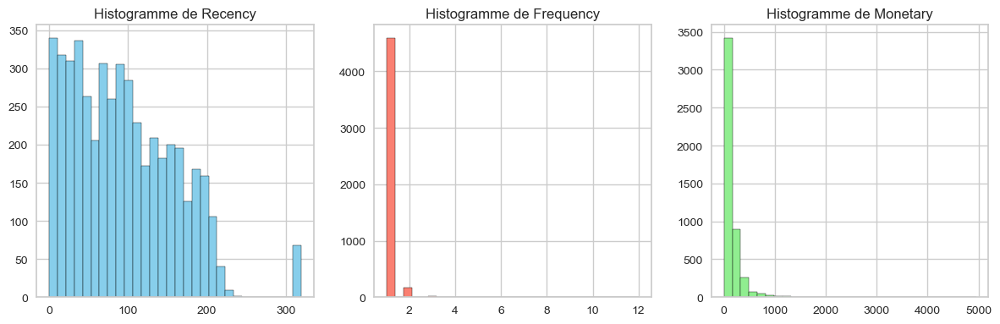

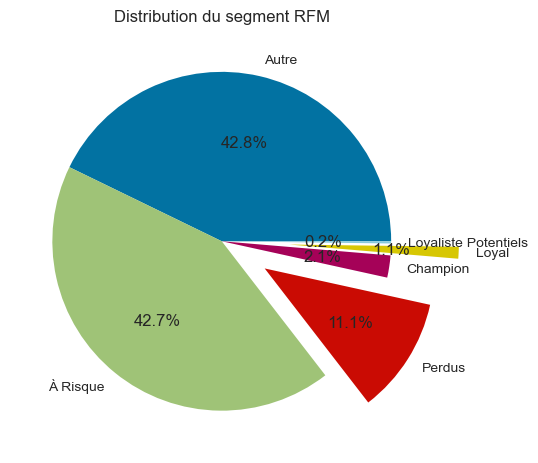

In [38]:
import matplotlib.pyplot as plt

# Histogramme de Recency
plt.figure(figsize=(12, 4))
plt.subplot(1, 3, 1)
plt.hist(rfm_data['Recency'], bins=30, color='skyblue', edgecolor='black')
plt.title('Histogramme de Recency')

# Histogramme de Frequency
plt.subplot(1, 3, 2)
plt.hist(rfm_data['Frequency'], bins=30, color='salmon', edgecolor='black')
plt.title('Histogramme de Frequency')

# Histogramme de Monetary
plt.subplot(1, 3, 3)
plt.hist(rfm_data['Monetary'], bins=30, color='lightgreen', edgecolor='black')
plt.title('Histogramme de Monetary')

plt.tight_layout()
plt.show()

# Créez un diagramme circulaire de la distribution du segment RFM avec explode
explode = (0., 0, 0.3, 0, 0.4, 0)  # Modifiez ces valeurs selon votre préférence
plt.pie(rfm_data["RFM_Segment"].value_counts(), labels=rfm_data["RFM_Segment"].unique(), autopct='%1.1f%%', explode=explode)
plt.title("Distribution du segment RFM")
plt.show()

## Diagramme à barres du segment RFM


Segment: Autre
Nombre de clients: 2050
Fréquence moyenne: 1.02
Montant monétaire moyen: 164.6316780487805

Segment: Champion
Nombre de clients: 101
Fréquence moyenne: 2.287128712871287
Montant monétaire moyen: 478.7055445544554

Segment: Loyal
Nombre de clients: 54
Fréquence moyenne: 2.2222222222222223
Montant monétaire moyen: 622.0166666666665

Segment: Loyaliste Potentiels
Nombre de clients: 10
Fréquence moyenne: 2.4
Montant monétaire moyen: 26.107

Segment: Perdus
Nombre de clients: 531
Fréquence moyenne: 1.0
Montant monétaire moyen: 35.67757062146893

Segment: À Risque
Nombre de clients: 2044
Fréquence moyenne: 1.0
Montant monétaire moyen: 179.36974070450097


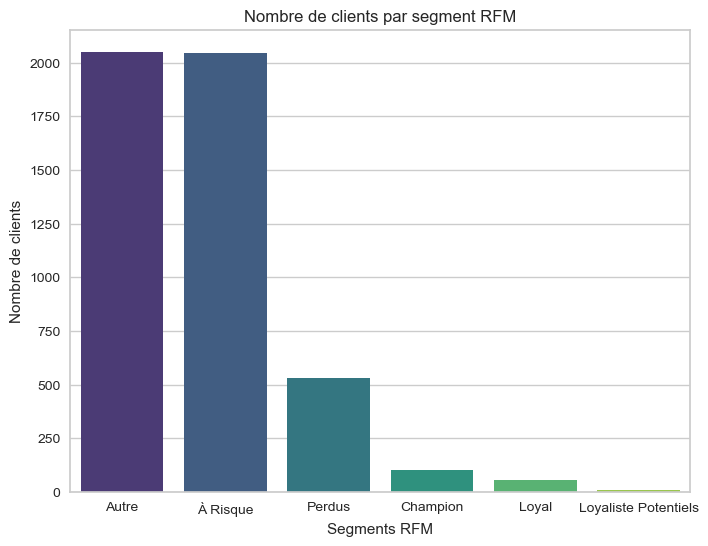

In [39]:
# Créez des groupes par RFM
rfm_groups = rfm_data.groupby("RFM_Segment")

# Affichez des statistiques de base pour chaque groupe
for group_name, group_data in rfm_groups:
    print(f"\nSegment: {group_name}")
    print("Nombre de clients:", group_data.shape[0])
    print("Fréquence moyenne:", group_data["Frequency"].mean())
    print("Montant monétaire moyen:", group_data["Monetary"].mean())
    
# Diagramme à barres du segment RFM
plt.figure(figsize=(8, 6))
sns.countplot(x='RFM_Segment', data=rfm_data, palette='viridis')
plt.title('Nombre de clients par segment RFM')
plt.xlabel('Segments RFM')
plt.ylabel('Nombre de clients')
plt.show()

## Diagramme à barres empilées pour voir la répartition des segments dans chaque cluster

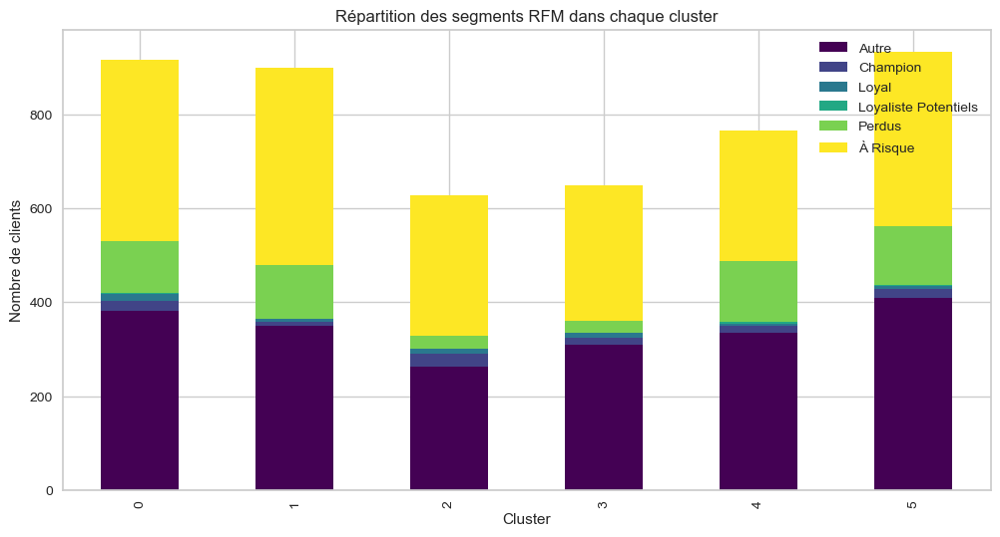

In [40]:
# Diagramme à barres empilées pour voir la répartition des segments dans chaque cluster
rfm_cluster_counts = rfm_data.groupby(['cluster', 'RFM_Segment']).size().unstack()
ax = rfm_cluster_counts.plot(kind='bar', stacked=True, colormap='viridis', figsize=(12, 6))

# Titre et étiquettes des axes
plt.title('Répartition des segments RFM dans chaque cluster')
plt.xlabel('Cluster')
plt.ylabel('Nombre de clients')

# Placer la légende en haut à droite
ax.legend(loc='upper right')

plt.show()


## Groupby pour savoir quels clients appartiennent à chaque segment RFM et cluster


<Figure size 1200x800 with 0 Axes>

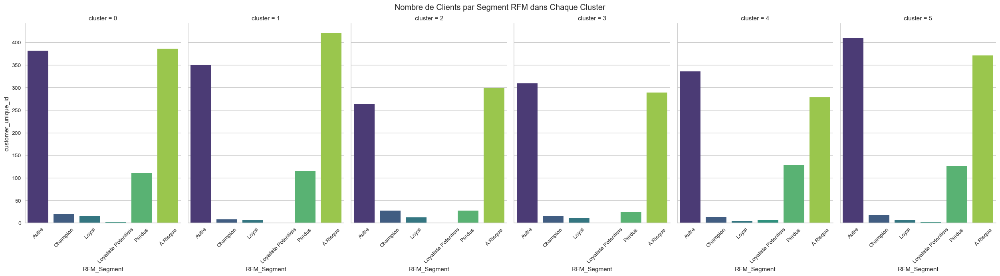

In [41]:
# Groupby par RFM_Segment et cluster pour obtenir le nombre de clients
rfm_cluster_counts = rfm_data.groupby(['RFM_Segment', 'cluster'])['customer_unique_id'].count().reset_index()
# Catplot pour visualiser le nombre de clients par segment RFM et cluster
plt.figure(figsize=(12, 8))
plot = sns.catplot(x='RFM_Segment', y='customer_unique_id', col='cluster', data=rfm_cluster_counts, kind='bar', height=6, aspect=0.7, palette='viridis')

# Faire pivoter les étiquettes de l'axe x à 90 degrés
plot.set_xticklabels(rotation=45)

plt.suptitle("Nombre de Clients par Segment RFM dans Chaque Cluster", y=1.02)
plt.show()

## Violinplot pour visualiser la distribution de Recency, Frequency et Monetary par segment RFM

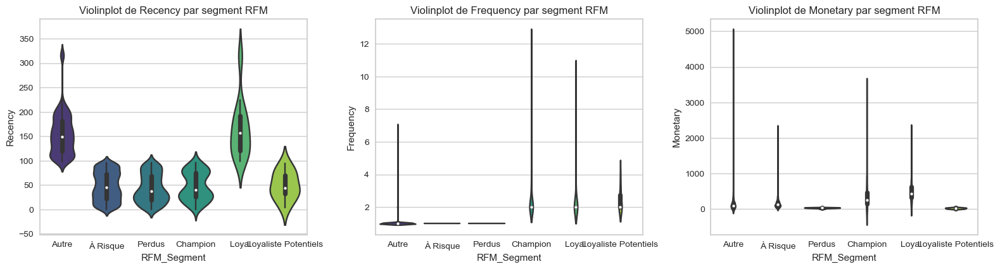

In [42]:
# Violinplot pour visualiser la distribution de Recency, Frequency et Monetary par segment RFM
plt.figure(figsize=(16, 8))
for i, var in enumerate(['Recency', 'Frequency', 'Monetary']):
    plt.subplot(2, 3, i + 1)
    sns.violinplot(x='RFM_Segment', y=var, data=rfm_data, palette='viridis')
    plt.title(f'Violinplot de {var} par segment RFM')

plt.tight_layout()
plt.show()



Cluster: 0
Nombre de clients: 915
Fréquence moyenne: 1.0546448087431695
Montant monétaire moyen: 137.95612021857923

Cluster: 1
Nombre de clients: 900
Fréquence moyenne: 1.021111111111111
Montant monétaire moyen: 134.68096666666665

Cluster: 2
Nombre de clients: 628
Fréquence moyenne: 1.0907643312101911
Montant monétaire moyen: 215.6686624203822

Cluster: 3
Nombre de clients: 649
Fréquence moyenne: 1.0585516178736518
Montant monétaire moyen: 372.27671802773494

Cluster: 4
Nombre de clients: 765
Fréquence moyenne: 1.065359477124183
Montant monétaire moyen: 95.92615686274509

Cluster: 5
Nombre de clients: 933
Fréquence moyenne: 1.0396570203644158
Montant monétaire moyen: 115.1092926045016


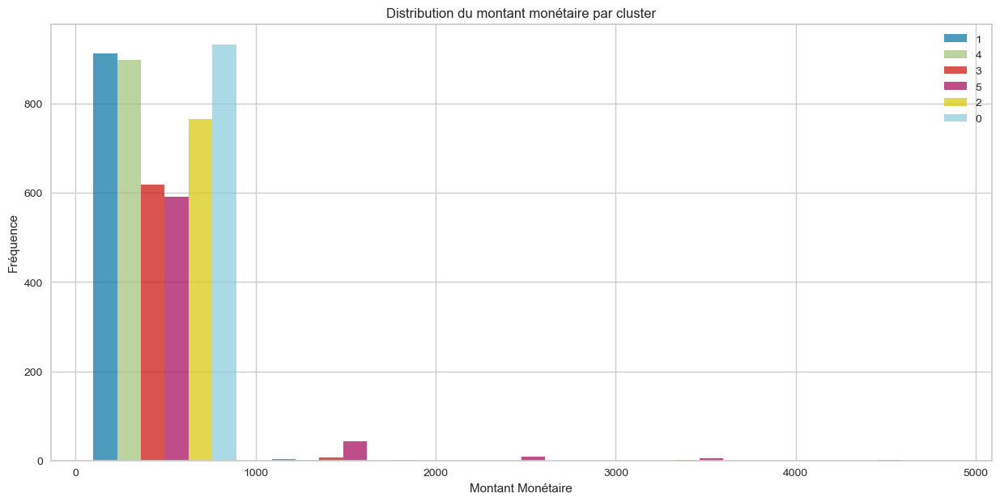

In [43]:
# Créez des groupes par cluster
cluster_groups = rfm_data.groupby("cluster")

# Affichez des statistiques de base pour chaque groupe
for group_name, group_data in cluster_groups:
    print(f"\nCluster: {group_name}")
    print("Nombre de clients:", group_data.shape[0])
    print("Fréquence moyenne:", group_data["Frequency"].mean())
    print("Montant monétaire moyen:", group_data["Monetary"].mean())

    
plt.figure(figsize=(15, 7))
plt.hist([group_data["Monetary"] for group_name, group_data in cluster_groups], bins=5, alpha=0.7, label=rfm_data["cluster"].unique())
plt.title("Distribution du montant monétaire par cluster")
plt.xlabel("Montant Monétaire")
plt.ylabel("Fréquence")
plt.legend()
plt.show()

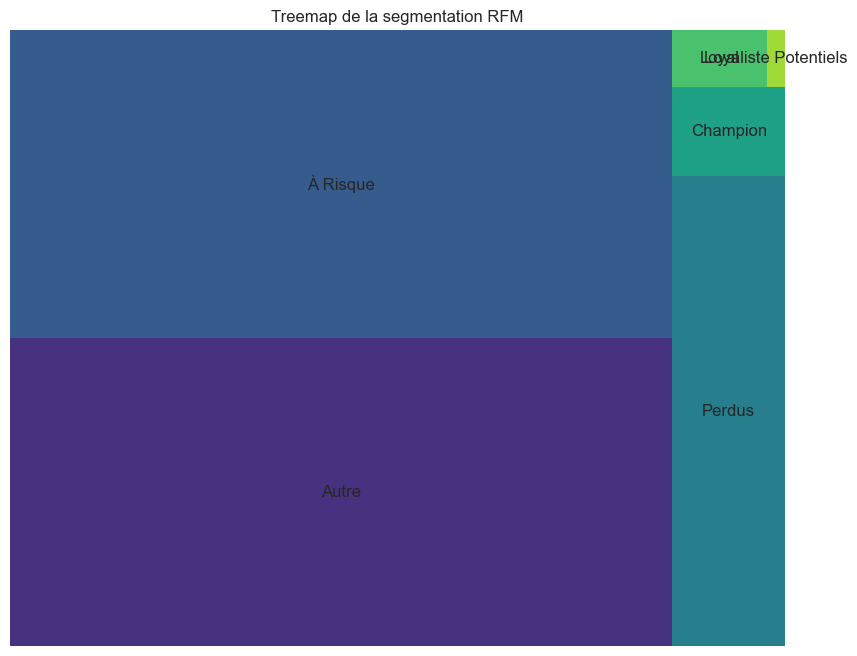

In [44]:
import squarify

# Grouper les données par segment RFM et compter le nombre de clients
rfm_segment_counts = rfm_data['RFM_Segment'].value_counts()

# Créer le treemap
plt.figure(figsize=(10, 8))
squarify.plot(sizes=rfm_segment_counts, label=rfm_segment_counts.index, color=sns.color_palette('viridis', n_colors=len(rfm_segment_counts)))

# Ajouter des labels et un titre
plt.title('Treemap de la segmentation RFM')
plt.axis('off')  # Supprimer les axes

# Afficher le treemap
plt.show()


In [45]:
import plotly.express as px

# Grouper les données par segment RFM et compter le nombre de clients
rfm_segment_counts = rfm_data['RFM_Segment'].value_counts().reset_index()

# Renommer les colonnes
rfm_segment_counts.columns = ['RFM_Segment', 'Count']

# Créer le treemap interactif avec Plotly Express
fig = px.treemap(rfm_segment_counts, path=['RFM_Segment'], values='Count', title='Treemap de la segmentation RFM')

# Afficher le treemap interactif
fig.show()


In [46]:
df_cluster_sample.head()

,order_id,order_item_id,product_id,seller_id,price,freight_value,product_category_name,payment_type,payment_installments,payment_value,customer_id,order_approved_at,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,review_score,seller_zip_code_prefix,seller_city,seller_state,customer_geo_lat,customer_geo_lng,seller_geo_lat,seller_geo_lng,time_between_orders_same_customer,days_between_orders_same_customer,hours_between_orders_same_customer,time_between_orders_all,days_between_orders_all,hours_between_orders_all,order_month,day_of_week,day_of_month,distance,cluster,Recency
46999,4c52483789e169329b0dc09e8139b7e2,1,1a080577618e7fe4d9ddd8fb2b47a964,4869f7a5dfa277a7dca6462dcf3b52b2,690.0,16.33,watches_gifts,credit_card,10,706.33,d4bb4211b01632ddd742d89807c73c82,2017-08-01 14:10:14,1e42daf0af58fb971d1598af1fd2497e,15056,sao jose do rio preto,SP,5,14840,guariba,SP,-20.775066,-49.348278,-21.362358,-48.232976,0 days,0,0,0 days 00:06:51,0,0,2017-08,Tuesday,1.0,132.898048,3,392
4363,ef4d010c07e5ac58d6b9b8f0210df881,1,afbe1e973aefbf72a330e3bc72d4b476,4a3ca9315b744ce9f8e9374361493884,68.9,15.23,bed_bath_table,boleto,1,84.13,e85df93b88aa497ab874a3afadc56bb0,2017-07-07 02:50:36,eda50d1b4b64e6dc8058e29f5fe65c79,35902,itabira,MG,5,14940,ibitinga,SP,-19.652557,-43.200084,-21.766477,-48.831547,0 days,0,0,0 days 00:00:01,0,0,2017-07,Friday,7.0,631.521737,5,418
48878,1c709af6dc28e45be0dda17b368271df,1,ca140156f7f81f8e406cc66cb8f12a67,6edacfd9f9074789dad6d62ba7950b9c,73.9,9.27,furniture_decor,credit_card,1,83.17,1dd47f0ace79cd4c8b2e0e3e428dc290,2018-08-21 10:50:54,f076fbbb7fc6c69d95e705c8e9561618,5596,sao paulo,SP,3,7135,guarulhos,SP,-23.581214,-46.745350,-23.422313,-46.520062,0 days,0,0,0 days 00:00:00,0,0,2018-08,Tuesday,21.0,28.968920,4,7
48082,acbaf2e843c77c9749c79030163c8b81,1,e8a2ee67401eb29a9eba28e2eab61a8b,e5a3438891c0bfdb9394643f95273d8e,13.3,15.10,fashion_bags_accessories,credit_card,2,28.40,82c4ae9f59304faecc7ea3ef42b253f4,2018-03-03 14:10:37,14843983d4a159080f6afe4b7f346e7c,24220,niteroi,RJ,1,13483,limeira,SP,-22.905817,-43.106989,-22.568350,-47.447439,0 days,0,0,0 days 00:00:00,0,0,2018-03,Saturday,3.0,447.397792,2,178
22131,ca2c48ff635d7bd831194de9207ca62d,1,368c6c730842d78016ad823897a372db,1f50f920176fa81dab994f9023523100,59.0,13.43,garden_tools,credit_card,7,72.43,22688d19d082732ac2ba2cb6f3e6b21e,2017-12-19 13:42:58,9046541463206bb0f8dcba0018853adc,13309,itu,SP,5,15025,sao jose do rio preto,SP,-23.280240,-47.284083,-20.802436,-49.395624,0 days,0,0,0 days 00:00:06,0,0,2017-12,Tuesday,19.0,350.402247,1,252


In [47]:
import joblib

# Enregistrez le DataFrame dans un fichier Joblib
joblib.dump(df_cluster_sample, 'df_cluster_sample.joblib')

['df_cluster_sample.joblib']

# TEST CLUSTERING SUR RFM

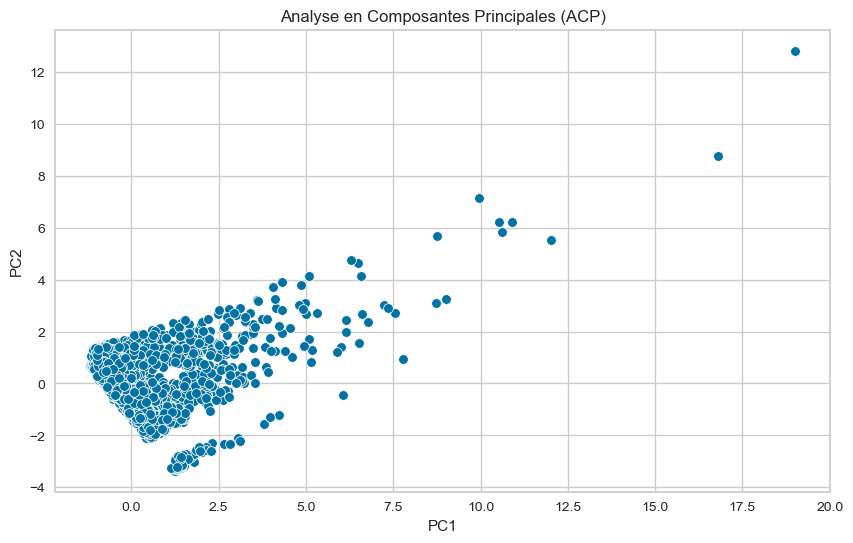

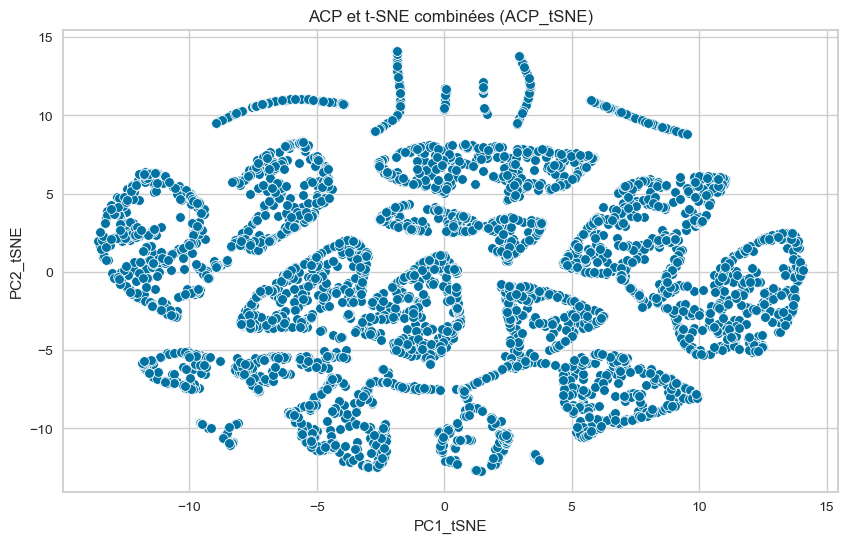

In [56]:
#                                                    rfm_data

# Import des bibliothèques nécessaires
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Échantillonnage des données
#df_cluster_sample = df_cluster.sample(frac=0.2, random_state=42)

# Copie du DataFrame pour éviter de modifier les données originales
df_encoded = rfm_data.copy()

df_encoded.set_index('customer_unique_id', inplace=True)

# Séparation des colonnes numériques et catégoriques
df_numeric = df_encoded.select_dtypes(include=['float64', 'int64'])
df_categorical = df_encoded.select_dtypes(include=['category', 'object', 'bool'])

# Utiliser OneHotEncoder pour encoder les variables catégoriques
encoder = OneHotEncoder(drop='first', sparse=False)
df_categorical_encoded = encoder.fit_transform(df_categorical)

# Standardisation des données numériques
scaler = StandardScaler()
df_numeric_scaled = scaler.fit_transform(df_numeric)

# Concaténer les données encodées
X = pd.concat([pd.DataFrame(df_numeric_scaled, columns=df_numeric.columns),
               pd.DataFrame(df_categorical_encoded, columns=encoder.get_feature_names_out(df_categorical.columns))],
              axis=1)

# Analyse en Composantes Principales (ACP) sur l'ensemble des données
pca = PCA(n_components=2)
pca_result = pca.fit_transform(X)
df_pca = pd.DataFrame(data=pca_result, columns=['PC1', 'PC2'])

# Visualisation ACP
plt.figure(figsize=(10, 6))
sns.scatterplot(x='PC1', y='PC2', data=df_pca)
plt.title('Analyse en Composantes Principales (ACP)')
plt.show()

# t-SNE sur l'ensemble des données
tsne = TSNE(n_components=2, perplexity=30, n_iter=300)
tsne_result = tsne.fit_transform(X)
df_tsne = pd.DataFrame(data=tsne_result, columns=['t-SNE1', 't-SNE2'])

# Analyse en Composantes Principales (ACP) et t-SNE combinées (ACP_tSNE)
pca_tsne = PCA(n_components=2)
pca_tsne_result = pca_tsne.fit_transform(tsne_result)
df_pca_tsne = pd.DataFrame(data=pca_tsne_result, columns=['PC1_tSNE', 'PC2_tSNE'])

# Visualisation ACP et t-SNE combinées
plt.figure(figsize=(10, 6))
sns.scatterplot(x='PC1_tSNE', y='PC2_tSNE', data=df_pca_tsne)
plt.title('ACP et t-SNE combinées (ACP_tSNE)')
plt.show()


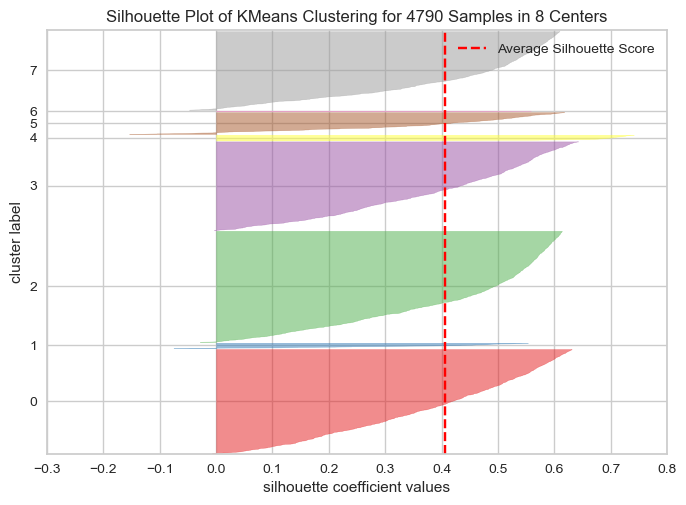

Score de silhouette pour k=8: 0.40606058860519584


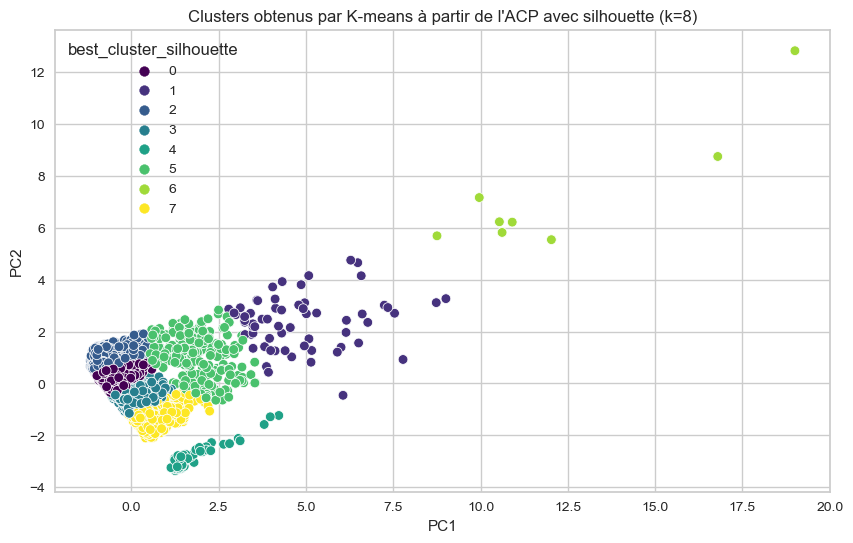

In [57]:
#                                                    rfm_data
from sklearn.cluster import KMeans
from yellowbrick.cluster import SilhouetteVisualizer
from sklearn.metrics import silhouette_score, davies_bouldin_score

# Appliquer la méthode de silhouette sur les résultats de l'ACP
model_pca_silhouette = KMeans(random_state=42)
visualizer_pca_silhouette = SilhouetteVisualizer(model_pca_silhouette, k=(2, 10), timings=False)

visualizer_pca_silhouette.fit(df_pca[['PC1', 'PC2']])
visualizer_pca_silhouette.show()

# Meilleur nombre de clusters pour l'ACP en utilisant la silhouette
best_k_pca_silhouette = visualizer_pca_silhouette.n_clusters_
kmeans_best_pca_silhouette = KMeans(n_clusters=best_k_pca_silhouette, random_state=42)
df_pca['best_cluster_silhouette'] = kmeans_best_pca_silhouette.fit_predict(df_pca[['PC1', 'PC2']])

# Calcul du score de silhouette pour le meilleur k
silhouette_avg = silhouette_score(df_pca[['PC1', 'PC2']], df_pca['best_cluster_silhouette'])
print(f"Score de silhouette pour k={best_k_pca_silhouette}: {silhouette_avg}")

# Visualisation des clusters pour l'ACP avec le meilleur k en utilisant la silhouette
plt.figure(figsize=(10, 6))
sns.scatterplot(x='PC1', y='PC2', hue='best_cluster_silhouette', data=df_pca, palette='viridis', legend='full')
plt.title(f'Clusters obtenus par K-means à partir de l\'ACP avec silhouette (k={best_k_pca_silhouette})')
plt.show()



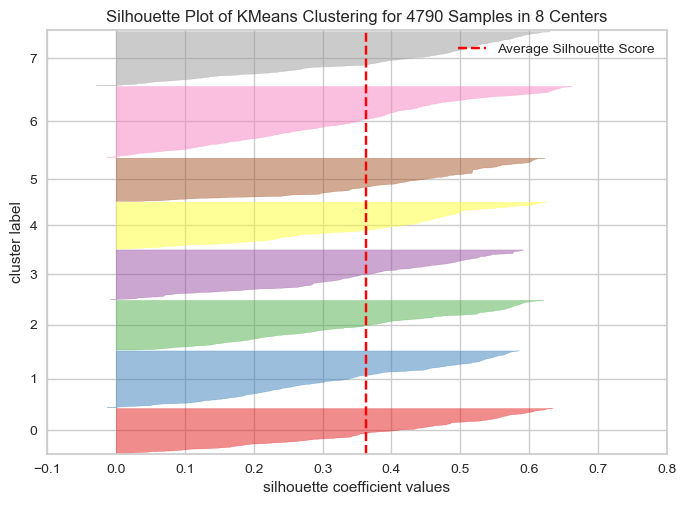

Silhouette Score (ACP_T-SNE, 2 clusters): 0.34215280413627625
Davies-Bouldin Score (ACP_T-SNE, 2 clusters): 1.2008002181017159
----------------------------------------
Silhouette Score (ACP_T-SNE, 3 clusters): 0.3720562160015106
Davies-Bouldin Score (ACP_T-SNE, 3 clusters): 0.8867839958954683
----------------------------------------
Silhouette Score (ACP_T-SNE, 4 clusters): 0.3676210343837738
Davies-Bouldin Score (ACP_T-SNE, 4 clusters): 0.8383075642046299
----------------------------------------
Silhouette Score (ACP_T-SNE, 5 clusters): 0.35279422998428345
Davies-Bouldin Score (ACP_T-SNE, 5 clusters): 0.8855246985664478
----------------------------------------
Silhouette Score (ACP_T-SNE, 6 clusters): 0.3831203877925873
Davies-Bouldin Score (ACP_T-SNE, 6 clusters): 0.7872214897167175
----------------------------------------
Silhouette Score (ACP_T-SNE, 7 clusters): 0.3735354542732239
Davies-Bouldin Score (ACP_T-SNE, 7 clusters): 0.7723575645310691
-------------------------------------

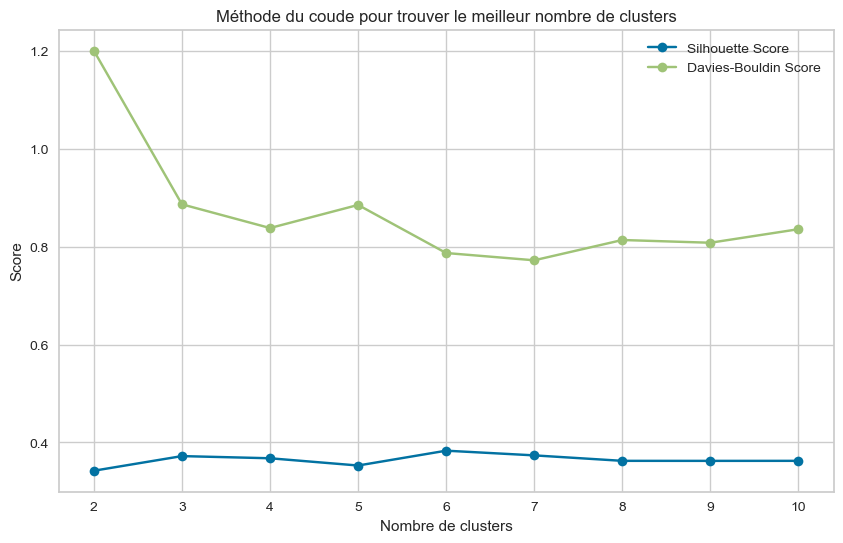

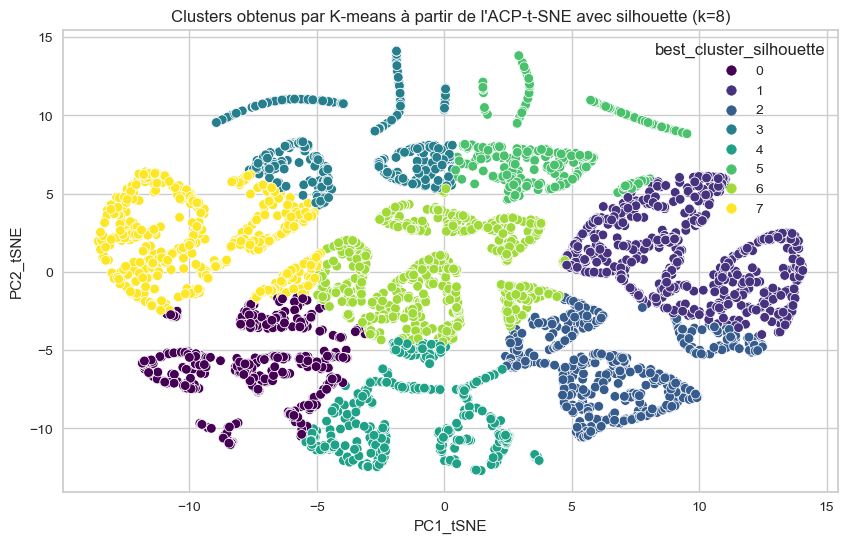

In [58]:
#                                                    rfm_data
# Appliquer la méthode de silhouette sur les résultats de t-SNE
model_combined_silhouette = KMeans(random_state=42)
visualizer_combined_silhouette = SilhouetteVisualizer(model_combined_silhouette, k=(2, 10), timings=False)

visualizer_combined_silhouette.fit(df_pca_tsne[['PC1_tSNE', 'PC2_tSNE']])
visualizer_combined_silhouette.show()

# Trouver le meilleur nombre de clusters pour t-SNE en utilisant la silhouette
best_k_combined_silhouette = visualizer_combined_silhouette.n_clusters_
df_pca_tsne['best_cluster_silhouette'] = model_combined_silhouette.fit_predict(df_pca_tsne[['PC1_tSNE', 'PC2_tSNE']])

# Afficher les scores de silhouette et Davies-Bouldin pour différentes valeurs de k
silhouette_scores_kmean = []
davies_bouldin_scores_kmean = []



for i in range(2, 11):
    kmeans_best_combined_silhouette = KMeans(n_clusters=i, random_state=42)
    X = df_pca_tsne[['PC1_tSNE', 'PC2_tSNE']]
    clusters = kmeans_best_combined_silhouette.fit_predict(X)
    
    silhouette_avg_combined = silhouette_score(X, clusters)
    davies_bouldin_avg_combined = davies_bouldin_score(X, clusters)
    
    silhouette_scores_kmean.append(silhouette_avg_combined)
    davies_bouldin_scores_kmean.append(davies_bouldin_avg_combined)
    
    
    print(f"Silhouette Score (ACP_T-SNE, {i} clusters): {silhouette_avg_combined}")
    print(f"Davies-Bouldin Score (ACP_T-SNE, {i} clusters): {davies_bouldin_avg_combined}")
    print("-" * 40)

# Tracer le graphique du coude
plt.figure(figsize=(10, 6))
plt.plot(range(2, 11), silhouette_scores_kmean, marker='o', label='Silhouette Score')
plt.plot(range(2, 11), davies_bouldin_scores_kmean, marker='o', label='Davies-Bouldin Score')
plt.title('Méthode du coude pour trouver le meilleur nombre de clusters')
plt.xlabel('Nombre de clusters')
plt.ylabel('Score')
plt.legend()
plt.show()


# Visualisation des clusters pour l'ACP-t-SNE avec le meilleur k en utilisant la silhouette
plt.figure(figsize=(10, 6))
sns.scatterplot(x='PC1_tSNE', y='PC2_tSNE', hue='best_cluster_silhouette', data=df_pca_tsne, palette='viridis', legend='full')
plt.title(f'Clusters obtenus par K-means à partir de l\'ACP-t-SNE avec silhouette (k={best_k_combined_silhouette})')
plt.show()



In [59]:
#                                     RFM
# Créer un DataFrame avec les scores
scores_df = pd.DataFrame({
    'Nombre de clusters': range(2, 11),
    'Silhouette Score kmean': silhouette_scores_kmean,
    'Davies-Bouldin Score kmean': davies_bouldin_scores_kmean
})

# Afficher le DataFrame
scores_df




,Nombre de clusters,Silhouette Score kmean,Davies-Bouldin Score kmean
0,2,0.342153,1.200800
1,3,0.372056,0.886784
2,4,0.367621,0.838308
3,5,0.352794,0.885525
4,6,0.383120,0.787221
5,7,0.373535,0.772358
6,8,0.362359,0.813835
7,9,0.362287,0.808226
8,10,0.362355,0.835916


In [ ]:
DBSCAN RFM

Nombre de clusters obtenus par DBSCAN : 4
Silhouette Score (ACP): 0.5179751984477162


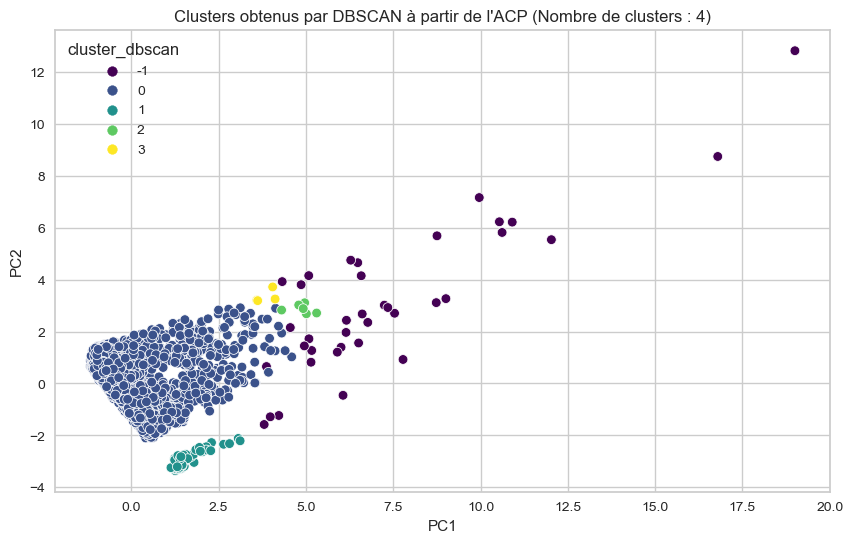

In [60]:
from sklearn.cluster import DBSCAN

# Standardisation des données pour DBSCAN avec ACP
scaler_dbscan_acp = StandardScaler()
df_pca_scaled = scaler_dbscan_acp.fit_transform(df_pca[['PC1', 'PC2']])

# Appliquer DBSCAN
dbscan_acp = DBSCAN(eps=0.5, min_samples=5)
df_pca['cluster_dbscan'] = dbscan_acp.fit_predict(df_pca_scaled)

# Afficher le nombre de clusters
num_clusters_dbscan = len(set(dbscan_acp.labels_)) - (1 if -1 in dbscan_acp.labels_ else 0)
print(f"Nombre de clusters obtenus par DBSCAN : {num_clusters_dbscan}")

# Calculer la silhouette moyenne
silhouette_avg_pca = silhouette_score(df_pca_scaled, df_pca['cluster_dbscan'])
print(f"Silhouette Score (ACP): {silhouette_avg_pca}")

# Visualisation des clusters pour ACP avec DBSCAN
plt.figure(figsize=(10, 6))
sns.scatterplot(x='PC1', y='PC2', hue='cluster_dbscan', data=df_pca, palette='viridis', legend='full')
plt.title(f'Clusters obtenus par DBSCAN à partir de l\'ACP (Nombre de clusters : {num_clusters_dbscan})')
plt.show()




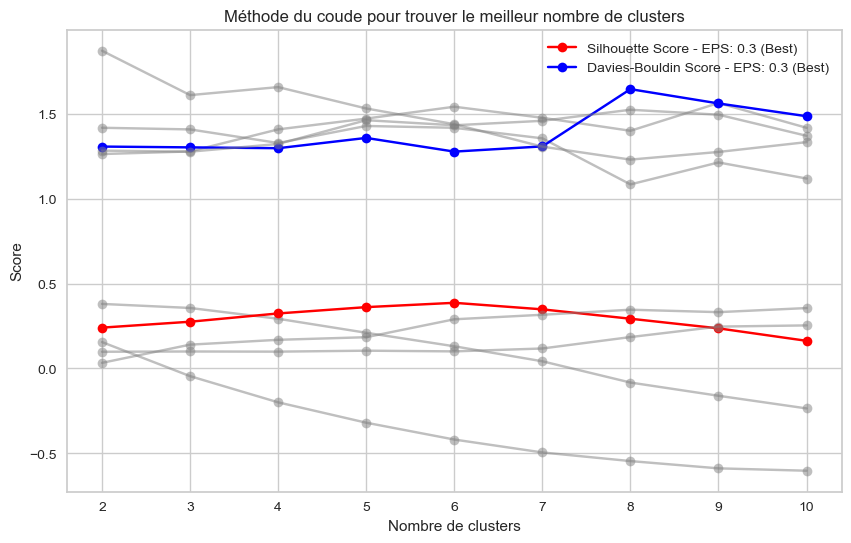

Meilleurs hyperparamètres - EPS: 0.3, Min Samples: 6
Score de silhouette pour DBSCAN avec les meilleurs hyperparamètres : 0.3870658278465271
Score Davies-Bouldin pour DBSCAN avec les meilleurs hyperparamètres : 1.277947160370762


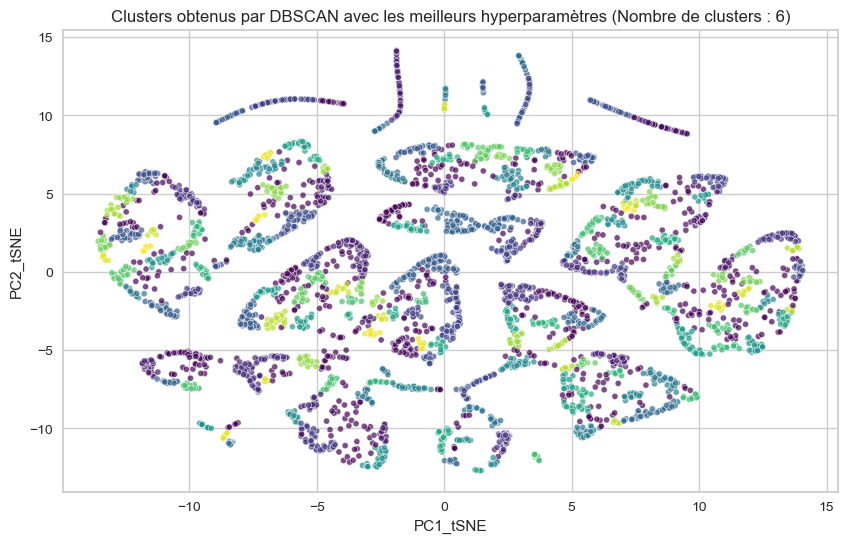

In [61]:
from sklearn.metrics import silhouette_score, davies_bouldin_score


# Hyperparamètres à tester
eps_values = [0.1, 0.2, 0.3, 0.4, 0.5]
min_samples_values = range(2, 11)

best_eps = None
best_min_samples = None
best_silhouette_score = -1
best_davies_bouldin_score = float('inf')

silhouette_scores_dbscan = []
davies_bouldin_scores_dbscan = []

# Tester les hyperparamètres
for eps in eps_values:
    silhouette_eps = []
    davies_bouldin_eps = []
    
    for min_samples in min_samples_values:
        dbscan_acp_tsne = DBSCAN(eps=eps, min_samples=min_samples)
        df_pca_tsne['cluster_dbscan'] = dbscan_acp_tsne.fit_predict(df_pca_tsne[['PC1_tSNE', 'PC2_tSNE']])
        
        silhouette_avg = silhouette_score(df_pca_tsne[['PC1_tSNE', 'PC2_tSNE']], df_pca_tsne['cluster_dbscan'])
        davies_bouldin_avg = davies_bouldin_score(df_pca_tsne[['PC1_tSNE', 'PC2_tSNE']], df_pca_tsne['cluster_dbscan'])
        
        silhouette_eps.append(silhouette_avg)
        davies_bouldin_eps.append(davies_bouldin_avg)
        
        if silhouette_avg > best_silhouette_score:
            best_eps = eps
            best_min_samples = min_samples
            best_silhouette_score = silhouette_avg
            best_davies_bouldin_score = davies_bouldin_avg
    
    silhouette_scores_dbscan.append(silhouette_eps)
    davies_bouldin_scores_dbscan.append(davies_bouldin_eps)

# Tracer le graphique du coude avec uniquement les meilleurs résultats
plt.figure(figsize=(10, 6))

for i, eps in enumerate(eps_values):
    if eps == best_eps:
        plt.plot(range(2, 11), silhouette_scores_dbscan[i], marker='o', label=f'Silhouette Score - EPS: {eps} (Best)', color='red')
        plt.plot(range(2, 11), davies_bouldin_scores_dbscan[i], marker='o', label=f'Davies-Bouldin Score - EPS: {eps} (Best)', color='blue')
    else:
        plt.plot(range(2, 11), silhouette_scores_dbscan[i], marker='o', alpha=0.5, color='gray')
        plt.plot(range(2, 11), davies_bouldin_scores_dbscan[i], marker='o', alpha=0.5, color='gray')

plt.title('Méthode du coude pour trouver le meilleur nombre de clusters')
plt.xlabel('Nombre de clusters')
plt.ylabel('Score')
plt.legend()
plt.show()

print(f"Meilleurs hyperparamètres - EPS: {best_eps}, Min Samples: {best_min_samples}")
print(f"Score de silhouette pour DBSCAN avec les meilleurs hyperparamètres : {best_silhouette_score}")
print(f"Score Davies-Bouldin pour DBSCAN avec les meilleurs hyperparamètres : {best_davies_bouldin_score}")

# Tracer le scatter plot avec le meilleur nombre de clusters
plt.figure(figsize=(10, 6))

# Utiliser les meilleurs hyperparamètres pour le clustering
best_dbscan_acp_tsne = DBSCAN(eps=best_eps, min_samples=best_min_samples)
df_pca_tsne['cluster_dbscan_best'] = best_dbscan_acp_tsne.fit_predict(df_pca_tsne[['PC1_tSNE', 'PC2_tSNE']])

# Afficher le scatter plot avec le meilleur nombre de clusters
plt.scatter(df_pca_tsne['PC1_tSNE'], df_pca_tsne['PC2_tSNE'], c=df_pca_tsne['cluster_dbscan_best'], cmap='viridis', s=20, alpha=0.7, marker='o', edgecolors='w', linewidth=0.5)

plt.title(f'Clusters obtenus par DBSCAN avec les meilleurs hyperparamètres (Nombre de clusters : {best_min_samples})')
plt.xlabel('PC1_tSNE')
plt.ylabel('PC2_tSNE')
plt.show()


In [62]:
# Créer un DataFrame avec les scores
scores_dbscan_df = pd.DataFrame({
    'Nombre de clusters': min_samples_values,
    'Silhouette Score dbscan': silhouette_scores_dbscan[eps_values.index(best_eps)],
    'Davies-Bouldin Score dbscan': davies_bouldin_scores_dbscan[eps_values.index(best_eps)]
})

# Afficher le DataFrame
scores_dbscan_df

,Nombre de clusters,Silhouette Score dbscan,Davies-Bouldin Score dbscan
0,2,0.240748,1.307656
1,3,0.275635,1.302938
2,4,0.324339,1.298047
3,5,0.361612,1.358627
4,6,0.387066,1.277947
5,7,0.348518,1.308641
6,8,0.293241,1.646027
7,9,0.236559,1.561767
8,10,0.163073,1.486441


# AC

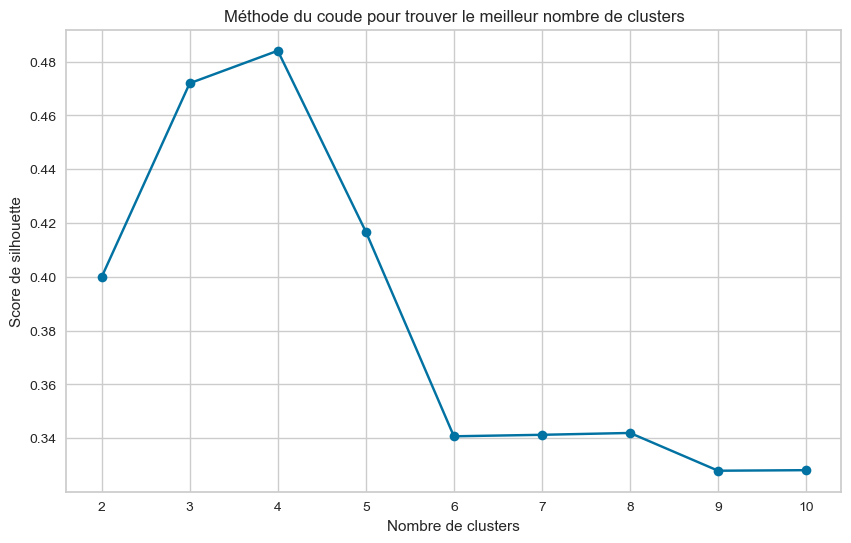

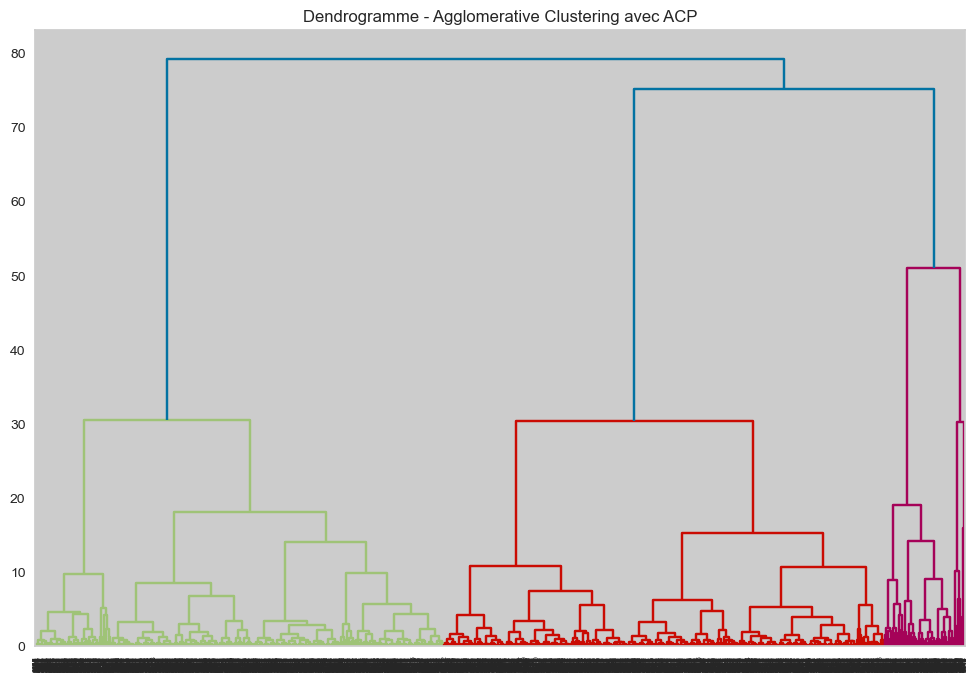

Meilleur nombre de clusters : 4


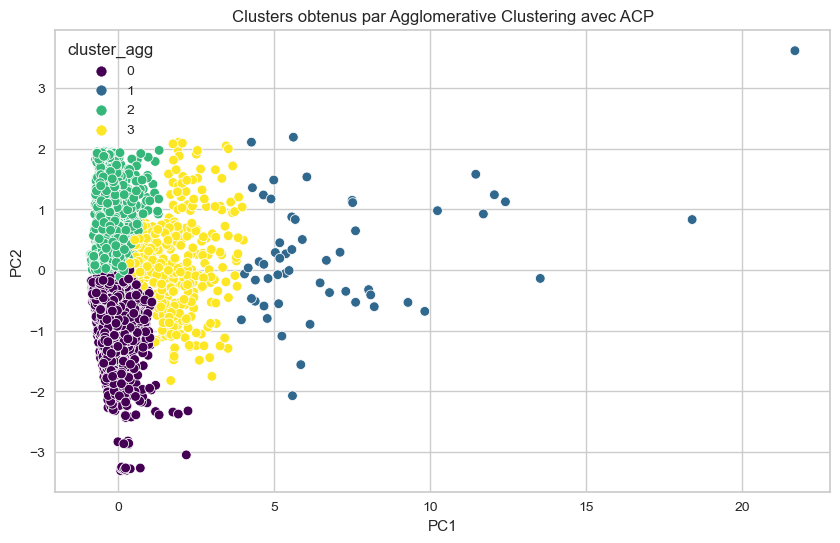

In [63]:
from sklearn.cluster import AgglomerativeClustering
from scipy.cluster.hierarchy import dendrogram, linkage

# Appliquer ACP
pca_ac = PCA(n_components=2)
pca_result_ac = pca_ac.fit_transform(df_numeric_scaled)
df_pca_ac = pd.DataFrame(data=pca_result_ac, columns=['PC1', 'PC2'])

# Trouver le meilleur nombre de clusters en utilisant la méthode du coude
silhouette_scores = []
for n_clusters in range(2, 11):  # Choisissez la plage appropriée
    agg_clustering_ac = AgglomerativeClustering(n_clusters=n_clusters)
    df_pca_ac['cluster_agg'] = agg_clustering_ac.fit_predict(df_pca_ac[['PC1', 'PC2']])
    silhouette_avg_agg_ac = silhouette_score(df_pca_ac[['PC1', 'PC2']], df_pca_ac['cluster_agg'])
    silhouette_scores.append(silhouette_avg_agg_ac)

# Tracer le graphique du coude
plt.figure(figsize=(10, 6))
plt.plot(range(2, 11), silhouette_scores, marker='o')
plt.title('Méthode du coude pour trouver le meilleur nombre de clusters')
plt.xlabel('Nombre de clusters')
plt.ylabel('Score de silhouette')
plt.show()

# Afficher le dendrogramme pour mieux comprendre la structure hiérarchique
linkage_matrix_ac = linkage(df_pca_ac[['PC1', 'PC2']], method='ward')
plt.figure(figsize=(12, 8))
dendrogram(linkage_matrix_ac)
plt.title('Dendrogramme - Agglomerative Clustering avec ACP')
plt.show()

# Choisissez le nombre de clusters en fonction du coude sur le graphique
best_num_clusters = silhouette_scores.index(max(silhouette_scores)) + 2
print(f"Meilleur nombre de clusters : {best_num_clusters}")

# Utiliser le meilleur nombre de clusters pour l'Agglomerative Clustering
agg_clustering_ac = AgglomerativeClustering(n_clusters=best_num_clusters)
df_pca_ac['cluster_agg'] = agg_clustering_ac.fit_predict(df_pca_ac[['PC1', 'PC2']])

# Visualisation des clusters
plt.figure(figsize=(10, 6))
sns.scatterplot(x='PC1', y='PC2', hue='cluster_agg', data=df_pca_ac, palette='viridis', legend='full')
plt.title('Clusters obtenus par Agglomerative Clustering avec ACP')
plt.show()

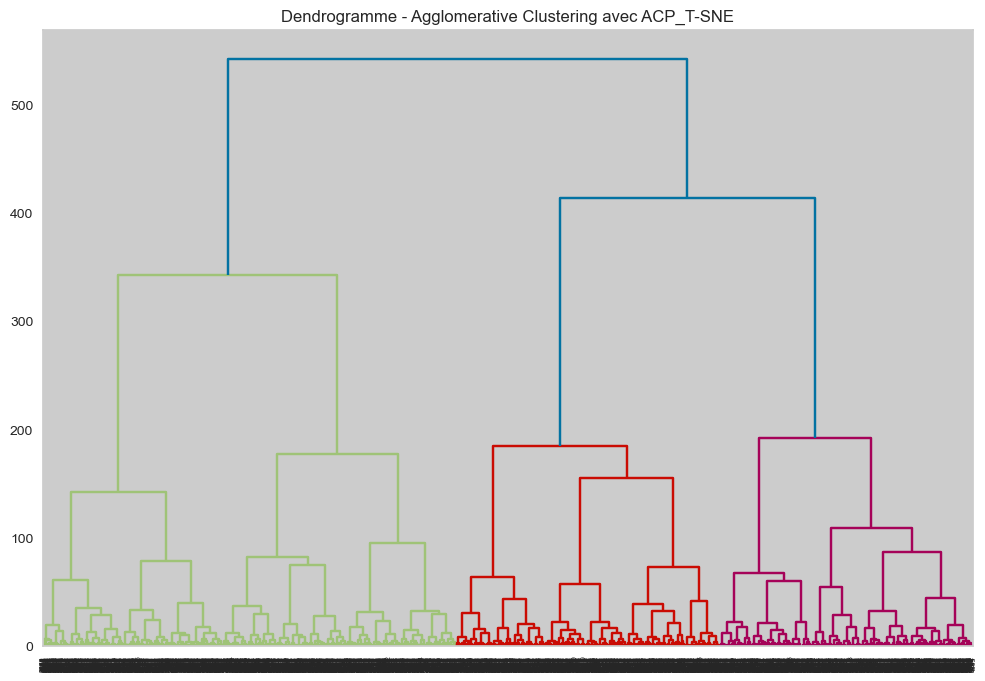

Nombre de clusters : 2
Score silhouette : 0.32709047198295593
Score Davies-Bouldin : 1.2347824928514664
----------------------------------------
Nombre de clusters : 3
Score silhouette : 0.32347822189331055
Score Davies-Bouldin : 0.9399360516557621
----------------------------------------
Nombre de clusters : 4
Score silhouette : 0.3359895348548889
Score Davies-Bouldin : 0.8971158683099956
----------------------------------------
Nombre de clusters : 5
Score silhouette : 0.3089850842952728
Score Davies-Bouldin : 0.9197273998795866
----------------------------------------
Nombre de clusters : 6
Score silhouette : 0.3041132986545563
Score Davies-Bouldin : 0.9743402378009131
----------------------------------------
Nombre de clusters : 7
Score silhouette : 0.303261935710907
Score Davies-Bouldin : 1.0147764967798791
----------------------------------------
Nombre de clusters : 8
Score silhouette : 0.30990278720855713
Score Davies-Bouldin : 0.9153703754742886
-------------------------------

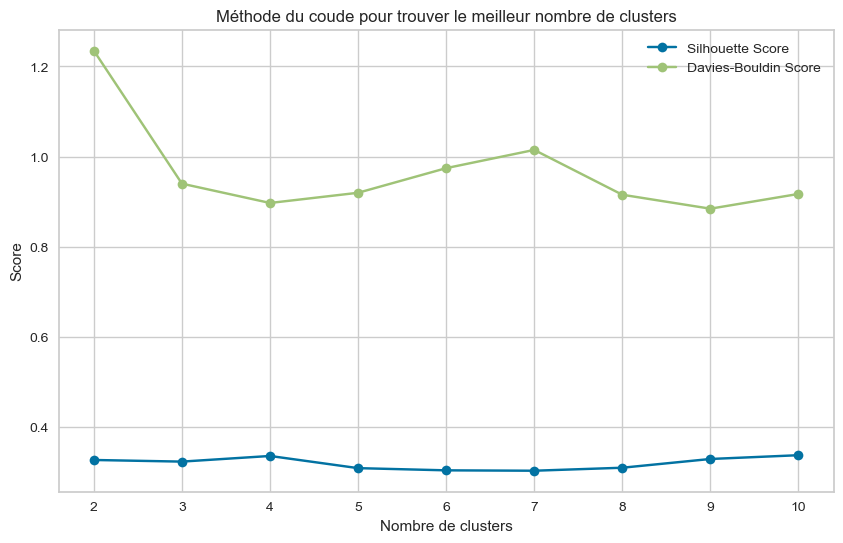

Meilleur nombre de clusters avec Silhouette : 10
Meilleur nombre de clusters avec Davies-Bouldin : 9


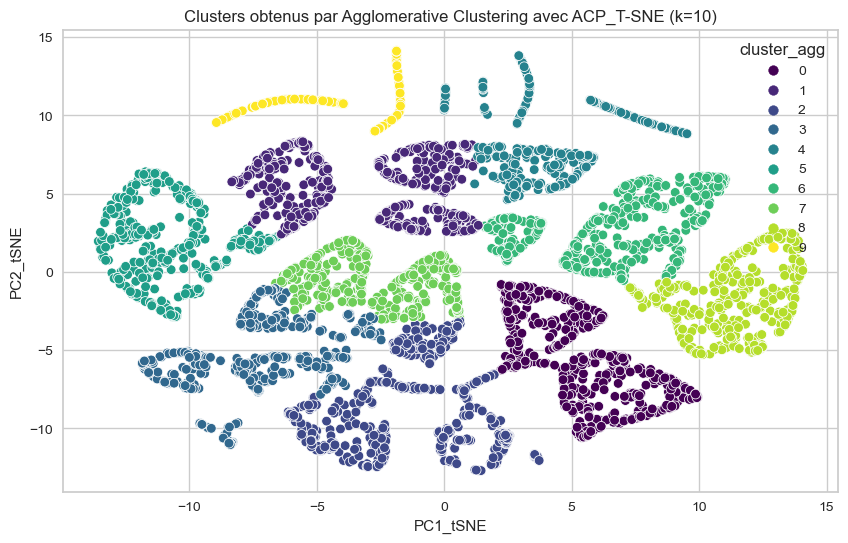

In [64]:


# Appliquer Agglomerative Clustering
agg_clustering_acp_tsne = AgglomerativeClustering()  # Ne pas spécifier le nombre de clusters initiaux
df_pca_tsne['cluster_agg'] = agg_clustering_acp_tsne.fit_predict(df_pca_tsne[['PC1_tSNE', 'PC2_tSNE']])

# Afficher le dendrogramme
linkage_matrix_acp_tsne = linkage(df_pca_tsne[['PC1_tSNE', 'PC2_tSNE']], method='ward')
plt.figure(figsize=(12, 8))
dendrogram(linkage_matrix_acp_tsne)
plt.title('Dendrogramme - Agglomerative Clustering avec ACP_T-SNE')
plt.show()

# Initialiser une liste pour stocker les résultats
results_acp_tsne = []

# Trouver le meilleur nombre de clusters en utilisant la méthode du coude
silhouette_scores_acp_tsne = []
davies_bouldin_scores_acp_tsne = []

for n_clusters in range(2, 11):  # Choisissez la plage appropriée
    # Agglomerative Clustering
    agg_clustering_acp_tsne = AgglomerativeClustering(n_clusters=n_clusters)
    df_pca_tsne['cluster_agg'] = agg_clustering_acp_tsne.fit_predict(df_pca_tsne[['PC1_tSNE', 'PC2_tSNE']])
    
    silhouette_avg_acp_tsne = silhouette_score(df_pca_tsne[['PC1_tSNE', 'PC2_tSNE']], df_pca_tsne['cluster_agg'])
    davies_bouldin_avg_acp_tsne = davies_bouldin_score(df_pca_tsne[['PC1_tSNE', 'PC2_tSNE']], df_pca_tsne['cluster_agg'])
    
    silhouette_scores_acp_tsne.append(silhouette_avg_acp_tsne)
    davies_bouldin_scores_acp_tsne.append(davies_bouldin_avg_acp_tsne)
    
    # Stocker les résultats dans la liste
    results_acp_tsne.append({
        'Nombre de clusters': n_clusters,
        'Score silhouette ac': silhouette_avg_acp_tsne,
        'Score Davies-Bouldin ac': davies_bouldin_avg_acp_tsne
    })
    
    # Afficher le nombre de clusters, le score de silhouette et le score Davies-Bouldin
    print(f"Nombre de clusters : {n_clusters}")
    print(f"Score silhouette : {silhouette_avg_acp_tsne}")
    print(f"Score Davies-Bouldin : {davies_bouldin_avg_acp_tsne}")
    print("-" * 40)

# Créer un DataFrame à partir de la liste des résultats
df_results_acp_tsne = pd.DataFrame(results_acp_tsne)

# Tracer le graphique du coude
plt.figure(figsize=(10, 6))
plt.plot(range(2, 11), silhouette_scores_acp_tsne, marker='o', label='Silhouette Score')
plt.plot(range(2, 11), davies_bouldin_scores_acp_tsne, marker='o', label='Davies-Bouldin Score')
plt.title('Méthode du coude pour trouver le meilleur nombre de clusters')
plt.xlabel('Nombre de clusters')
plt.ylabel('Score')
plt.legend()
plt.show()

# Choisissez le nombre de clusters en fonction du coude sur le graphique de la silhouette
best_num_clusters_acp_tsne_silhouette = silhouette_scores_acp_tsne.index(max(silhouette_scores_acp_tsne)) + 2
print(f"Meilleur nombre de clusters avec Silhouette : {best_num_clusters_acp_tsne_silhouette}")

# Choisissez le nombre de clusters en fonction du coude sur le graphique de Davies-Bouldin
best_num_clusters_acp_tsne_davies_bouldin = davies_bouldin_scores_acp_tsne.index(min(davies_bouldin_scores_acp_tsne)) + 2
print(f"Meilleur nombre de clusters avec Davies-Bouldin : {best_num_clusters_acp_tsne_davies_bouldin}")

# Utiliser le meilleur nombre de clusters pour l'Agglomerative Clustering
best_num_clusters_acp_tsne = best_num_clusters_acp_tsne_silhouette  # Choisissez celui qui vous convient le mieux
agg_clustering_acp_tsne = AgglomerativeClustering(n_clusters=best_num_clusters_acp_tsne)
df_pca_tsne['cluster_agg'] = agg_clustering_acp_tsne.fit_predict(df_pca_tsne[['PC1_tSNE', 'PC2_tSNE']])

# Visualisation des clusters
plt.figure(figsize=(10, 6))
sns.scatterplot(x='PC1_tSNE', y='PC2_tSNE', hue='cluster_agg', data=df_pca_tsne, palette='viridis', legend='full')
plt.title(f'Clusters obtenus par Agglomerative Clustering avec ACP_T-SNE (k={best_num_clusters_acp_tsne})')
plt.show()



In [65]:
#                                   RFM
# Ajouter la colonne 'Nombre de clusters' aux DataFrames
scores_df['Nombre de clusters'] = range(2, 11)
scores_dbscan_df['Nombre de clusters'] = range(2, 11)
df_results_acp_tsne['Nombre de clusters'] = range(2, 11)

# Fusionner les DataFrames en fonction de la colonne 'Nombre de clusters'
combined_df = pd.merge(scores_df, scores_dbscan_df, on='Nombre de clusters', how='outer')
combined_df = pd.merge(combined_df, df_results_acp_tsne, on='Nombre de clusters', how='outer')

# Afficher le DataFrame combiné
combined_df

,Nombre de clusters,Silhouette Score kmean,Davies-Bouldin Score kmean,Silhouette Score dbscan,Davies-Bouldin Score dbscan,Score silhouette ac,Score Davies-Bouldin ac
0,2,0.342153,1.200800,0.240748,1.307656,0.327090,1.234782
1,3,0.372056,0.886784,0.275635,1.302938,0.323478,0.939936
2,4,0.367621,0.838308,0.324339,1.298047,0.335990,0.897116
3,5,0.352794,0.885525,0.361612,1.358627,0.308985,0.919727
4,6,0.383120,0.787221,0.387066,1.277947,0.304113,0.974340
5,7,0.373535,0.772358,0.348518,1.308641,0.303262,1.014776
6,8,0.362359,0.813835,0.293241,1.646027,0.309903,0.915370
7,9,0.362287,0.808226,0.236559,1.561767,0.329310,0.884420
8,10,0.362355,0.835916,0.163073,1.486441,0.337674,0.917123


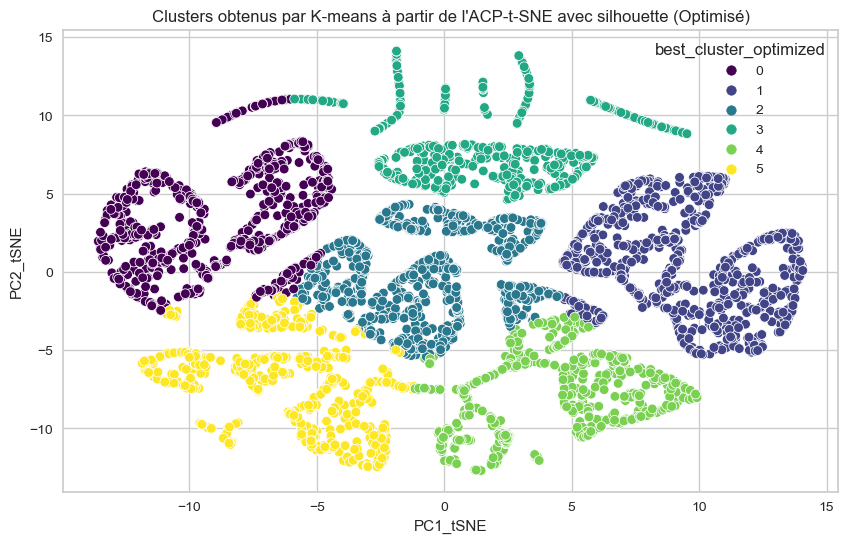

In [66]:
from sklearn.model_selection import ParameterGrid


# Données pour l'ACP-t-SNE
data_pca_tsne = df_pca_tsne[['PC1_tSNE', 'PC2_tSNE']]

# Définir les meilleurs hyperparamètres
best_params = {
    'n_clusters': 6,
    'init': 'k-means++',
    'max_iter': 300,
    'random_state': 42
}

# Initialiser et ajuster le modèle avec les meilleurs paramètres
best_kmeans = KMeans(**best_params)
df_pca_tsne['best_cluster_optimized'] = best_kmeans.fit_predict(data_pca_tsne)

# Visualisation des clusters pour l'ACP-t-SNE avec les meilleurs paramètres
plt.figure(figsize=(10, 6))
sns.scatterplot(x='PC1_tSNE', y='PC2_tSNE', hue='best_cluster_optimized', data=df_pca_tsne, palette='viridis', legend='full')
plt.title(f'Clusters obtenus par K-means à partir de l\'ACP-t-SNE avec silhouette (Optimisé)')
plt.show()
